# Исследовательский анализ данных (EDA) для Inria Aerial Image Labeling Dataset

---

## Описание

Данный ноутбук содержит комплексный исследовательский анализ данных (EDA) для набора данных Inria Aerial Image Labeling Dataset в рамках проекта обработки спутниковых снимков.

**Датасет:** Аэрофотоснимки высокого разрешения (5000×5000 пикселей, 30 см/пиксель, RGB) с бинарной разметкой для семантической сегментации (здание / не здание).

**Города в обучающей выборке:** Austin (TX), Chicago (IL), Kitsap County (WA), Vienna (Австрия), West Tyrol (Австрия)

---

## Связь с техническим заданием

Согласно ТЗ проекта:
- **Задача:** семантическая сегментация зданий на аэрофотоснимках
- **Результат:** веб-приложение (Streamlit/Gradio), которое принимает спутниковый снимок и выдаёт **площадь застройки в м²**
- **Ограничения:** training loop должен быть реализован самостоятельно (без Ultralytics, MMDet и аналогов)
- **Дополнительные баллы:** возможность самостоятельно разметить тестовую выборку (50+ изображений)

Данный EDA направлен на понимание данных для принятия решений по:
- Архитектуре модели и функции потерь
- Стратегии аугментации и нормализации
- Обработке дисбаланса классов
- Корректному расчёту площади (30 см/пиксель → 0.09 м²/пиксель)

---

## Цели анализа

1. Понимание структуры и характеристик данных
2. Анализ распределения пикселей и баланса классов
3. Сравнительный анализ между городами
4. Оценка domain shift между train и test выборками
5. Рекомендации по предобработке и аугментации

**Источник:** [Inria Aerial Image Labeling Benchmark](https://project.inria.fr/aerialimagelabeling/)

## 1. Импорт библиотек и настройка окружения

In [1]:
# Стандартные библиотеки
import re
import warnings
from pathlib import Path

# Работа с данными
import numpy as np
import pandas as pd

# Визуализация
import matplotlib.pyplot as plt
import seaborn as sns

# Обработка изображений
import tifffile
from skimage import measure
from skimage.color import rgb2gray
from skimage.feature import local_binary_pattern, graycomatrix, graycoprops

# Статистика
from scipy import stats, fft

# Прогресс-бар
from tqdm import tqdm

# Подавление предупреждений
warnings.filterwarnings('ignore')

print("Библиотеки успешно импортированы")

Библиотеки успешно импортированы


In [2]:
# Глобальные константы и пути

# Корневая директория проекта (относительно notebooks/)
PROJECT_ROOT = Path.cwd().parent
DATA_ROOT = PROJECT_ROOT / "data" / "raw"

# Пути к данным
TRAIN_IMAGES_DIR = DATA_ROOT / "train" / "images"
TRAIN_GT_DIR = DATA_ROOT / "train" / "gt"
TEST_IMAGES_DIR = DATA_ROOT / "test" / "images"

# Названия городов в обучающей выборке
TRAIN_CITIES = ["austin", "chicago", "kitsap", "tyrol-w", "vienna"]

# Названия городов в тестовой выборке (предполагаемые)
TEST_CITIES = ["bellingham", "bloomington", "innsbruck", "sfo", "tyrol-e"]

# Ожидаемые размеры изображений
EXPECTED_IMAGE_SHAPE = (5000, 5000, 3)
EXPECTED_MASK_SHAPE = (5000, 5000)

# Цветовая палитра для городов
CITY_COLORS = {
    "austin": "#1f77b4",
    "chicago": "#ff7f0e",
    "kitsap": "#2ca02c",
    "tyrol-w": "#d62728",
    "vienna": "#9467bd",
    "bellingham": "#8c564b",
    "bloomington": "#e377c2",
    "innsbruck": "#7f7f7f",
    "sfo": "#bcbd22",
    "tyrol-e": "#17becf",
}

# Цвета для RGB каналов
CHANNEL_COLORS = {"R": "#d62728", "G": "#2ca02c", "B": "#1f77b4"}

# Случайное зерно для воспроизводимости
RANDOM_SEED = 42
np.random.seed(RANDOM_SEED)

print(f"Корень проекта: {PROJECT_ROOT}")
print(f"Директория данных: {DATA_ROOT}")
print(f"Директория train изображений: {TRAIN_IMAGES_DIR}")
print(f"Директория train масок: {TRAIN_GT_DIR}")
print(f"Директория test изображений: {TEST_IMAGES_DIR}")
print(f"Существует: train_images={TRAIN_IMAGES_DIR.exists()}, train_gt={TRAIN_GT_DIR.exists()}, test_images={TEST_IMAGES_DIR.exists()}")

Корень проекта: /home/user/code/dls_project
Директория данных: /home/user/code/dls_project/data/raw
Директория train изображений: /home/user/code/dls_project/data/raw/train/images
Директория train масок: /home/user/code/dls_project/data/raw/train/gt
Директория test изображений: /home/user/code/dls_project/data/raw/test/images
Существует: train_images=True, train_gt=True, test_images=True


## 2. Загрузка и валидация данных

В этом разделе мы:
- Загрузим пути ко всем изображениям и маскам
- Извлечём названия городов из имён файлов
- Проверим количество файлов
- Создадим сводную таблицу по датасету

In [3]:
# Функция для получения списка TIF файлов и извлечения названия города из имени файла

def get_tif_files(directory: Path) -> list[Path]:
    """Возвращает отсортированный список путей к TIF файлам в директории."""
    return sorted(directory.glob("*.tif"))


def extract_city_from_filename(filename: str) -> str:
    """Извлекает название города из имени файла (например, 'austin1.tif' -> 'austin')."""
    # Удаляем расширение и цифры в конце
    name = Path(filename).stem
    city = re.sub(r'\d+$', '', name)
    return city.lower()


def load_file_info(directory: Path, file_type: str = "image") -> pd.DataFrame:
    """Загружает информацию о файлах в DataFrame."""
    files = get_tif_files(directory)
    
    data = []
    for f in files:
        city = extract_city_from_filename(f.name)
        data.append({
            "filename": f.name,
            "path": str(f),
            "city": city,
            "type": file_type,
        })
    
    return pd.DataFrame(data)


print("Функции для загрузки файлов определены")

Функции для загрузки файлов определены


In [4]:
# Загрузка информации о train изображениях
train_images_df = load_file_info(TRAIN_IMAGES_DIR, "train_image")
print(f"Загружено {len(train_images_df)} train изображений")
print(f"Города: {train_images_df['city'].unique().tolist()}")

Загружено 180 train изображений
Города: ['austin', 'chicago', 'kitsap', 'tyrol-w', 'vienna']


In [5]:
# Загрузка информации о ground truth масках
train_gt_df = load_file_info(TRAIN_GT_DIR, "train_mask")
print(f"Загружено {len(train_gt_df)} ground truth масок")
print(f"Города: {train_gt_df['city'].unique().tolist()}")

Загружено 180 ground truth масок
Города: ['austin', 'chicago', 'kitsap', 'tyrol-w', 'vienna']


In [6]:
# Загрузка информации о test изображениях
test_images_df = load_file_info(TEST_IMAGES_DIR, "test_image")
print(f"Загружено {len(test_images_df)} test изображений")
if len(test_images_df) > 0:
    print(f"Города: {test_images_df['city'].unique().tolist()}")
else:
    print("Test изображения не найдены")

Загружено 180 test изображений
Города: ['bellingham', 'bloomington', 'innsbruck', 'sfo', 'tyrol-e']


In [7]:
# Валидация количества файлов
EXPECTED_TRAIN_COUNT = 180
EXPECTED_GT_COUNT = 180
EXPECTED_TEST_COUNT = 180

validation_results = {
    "Набор данных": ["Train изображения", "Ground Truth маски", "Test изображения"],
    "Ожидаемое количество": [EXPECTED_TRAIN_COUNT, EXPECTED_GT_COUNT, EXPECTED_TEST_COUNT],
    "Фактическое количество": [len(train_images_df), len(train_gt_df), len(test_images_df)],
}

validation_df = pd.DataFrame(validation_results)
validation_df["Статус"] = validation_df.apply(
    lambda row: "OK" if row["Ожидаемое количество"] == row["Фактическое количество"] else "ОШИБКА",
    axis=1
)

print("Результаты валидации количества файлов:")
display(validation_df)

Результаты валидации количества файлов:


,Набор данных,Ожидаемое количество,Фактическое количество,Статус
0,Train изображения,180,180,OK
1,Ground Truth маски,180,180,OK
2,Test изображения,180,180,OK


In [8]:
# Сводная таблица по городам (Train)
train_summary = train_images_df.groupby("city").size().reset_index(name="количество_изображений")
# Размер изображения: 5000 x 5000 пикселей
train_summary["пикселей_на_изображение"] = 5000 * 5000
train_summary["всего_пикселей"] = train_summary["количество_изображений"] * train_summary["пикселей_на_изображение"]
# Площадь: 5000 * 0.3м = 1500м на сторону, площадь тайла = 1500 * 1500 = 2.25 км²
train_summary["площадь_км2"] = train_summary["количество_изображений"] * 2.25

print("Сводная статистика по городам (Train):")
display(train_summary)

print(f"\nВсего train изображений: {train_summary['количество_изображений'].sum()}")
print(f"Всего пикселей: {train_summary['всего_пикселей'].sum():,}")
print(f"Общая площадь покрытия: {train_summary['площадь_км2'].sum():.1f} км²")

Сводная статистика по городам (Train):


,city,количество_изображений,пикселей_на_изображение,всего_пикселей,площадь_км2
0,austin,36,25000000,900000000,81.0
1,chicago,36,25000000,900000000,81.0
2,kitsap,36,25000000,900000000,81.0
3,tyrol-w,36,25000000,900000000,81.0
4,vienna,36,25000000,900000000,81.0



Всего train изображений: 180
Всего пикселей: 4,500,000,000
Общая площадь покрытия: 405.0 км²


In [9]:
# Сводная таблица по городам (Test)
if len(test_images_df) > 0:
    test_summary = test_images_df.groupby("city").size().reset_index(name="количество_изображений")
    # Размер изображения: 5000 x 5000 пикселей
    test_summary["пикселей_на_изображение"] = 5000 * 5000
    test_summary["всего_пикселей"] = test_summary["количество_изображений"] * test_summary["пикселей_на_изображение"]
    # Площадь тайла = 2.25 км²
    test_summary["площадь_км2"] = test_summary["количество_изображений"] * 2.25

    print("Сводная статистика по городам (Test):")
    display(test_summary)

    print(f"\nВсего test изображений: {test_summary['количество_изображений'].sum()}")
    print(f"Всего пикселей: {test_summary['всего_пикселей'].sum():,}")
    print(f"Общая площадь покрытия: {test_summary['площадь_км2'].sum():.1f} км²")
else:
    print("Test images not found - skipping summary statistics")

Сводная статистика по городам (Test):


,city,количество_изображений,пикселей_на_изображение,всего_пикселей,площадь_км2
0,bellingham,36,25000000,900000000,81.0
1,bloomington,36,25000000,900000000,81.0
2,innsbruck,36,25000000,900000000,81.0
3,sfo,36,25000000,900000000,81.0
4,tyrol-e,36,25000000,900000000,81.0



Всего test изображений: 180
Всего пикселей: 4,500,000,000
Общая площадь покрытия: 405.0 км²


### Наблюдения по структуре данных

**Train набор:**
- 180 изображений, равномерно распределённых по 5 городам (по 36 на город)
- Города: Austin (TX), Chicago (IL), Kitsap County (WA), Vienna (Австрия), West Tyrol (Австрия)
- Каждое изображение: **5000 × 5000 пикселей**, RGB, uint8
- Разрешение: 30 см/пиксель → площадь тайла = 1500 × 1500 м = **2.25 км²**
- Общая площадь покрытия: 180 × 2.25 = **405 км²**

**Test набор:**
- 180 изображений (полный тестовый набор)
- Города отличаются от train: Bellingham, Bloomington, Innsbruck, San Francisco, East Tyrol
- **Важно для ТЗ:** модель должна обобщаться на новые города — это проверка генерализации

**Ground Truth:**
- Бинарные маски: 255 = здание, 0 = фон (5000 × 5000 пикселей)
- Соответствуют train изображениям по имени файла

**Для расчёта площади в м² (требование ТЗ):**
- 1 пиксель = 0.3 × 0.3 м = **0.09 м²**
- Площадь застройки = (количество пикселей зданий) × 0.09 м²

In [10]:
# Настройка стиля визуализации

# Установка стиля seaborn
sns.set_theme(style="whitegrid", palette="muted")

# Параметры matplotlib
plt.rcParams.update({
    "figure.figsize": (12, 8),
    "figure.dpi": 100,
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "xtick.labelsize": 10,
    "ytick.labelsize": 10,
    "legend.fontsize": 10,
    "font.size": 11,
    "axes.grid": True,
    "grid.alpha": 0.3,
})

print("Стиль визуализации настроен")

Стиль визуализации настроен


## 3. Базовая статистика изображений

В этом разделе мы:
- Проверим размеры и типы данных изображений
- Вычислим статистику по каналам RGB
- Выявим аномальные изображения

In [11]:
# Загрузка нескольких образцов изображений для проверки размеров и типов данных
sample_paths = train_images_df["path"].tolist()[:3]

print("Проверка размеров и типов данных на образцах:")
for path in sample_paths:
    img = tifffile.imread(path)
    print(f"  {Path(path).name}: shape={img.shape}, dtype={img.dtype}, min={img.min()}, max={img.max()}")

Проверка размеров и типов данных на образцах:
  austin1.tif: shape=(5000, 5000, 3), dtype=uint8, min=0, max=255
  austin10.tif: shape=(5000, 5000, 3), dtype=uint8, min=0, max=255
  austin11.tif: shape=(5000, 5000, 3), dtype=uint8, min=0, max=255


In [12]:
# Проверка размеров и типов данных для всех изображений
# Собираем информацию обо всех изображениях

image_info = []
anomalies = []

print("Проверка всех train изображений...")
for _, row in tqdm(train_images_df.iterrows(), total=len(train_images_df), desc="Train images"):
    img = tifffile.imread(row["path"])
    info = {
        "filename": row["filename"],
        "city": row["city"],
        "type": "train_image",
        "height": img.shape[0],
        "width": img.shape[1],
        "channels": img.shape[2] if len(img.shape) > 2 else 1,
        "dtype": str(img.dtype),
        "has_nan": np.isnan(img).any() if np.issubdtype(img.dtype, np.floating) else False,
    }
    image_info.append(info)
    
    # Проверка на аномалии
    if img.shape != EXPECTED_IMAGE_SHAPE:
        anomalies.append({"filename": row["filename"], "issue": f"Неожиданный размер: {img.shape}"})
    if info["has_nan"]:
        anomalies.append({"filename": row["filename"], "issue": "Содержит NaN значения"})

print("Проверка всех ground truth масок...")
for _, row in tqdm(train_gt_df.iterrows(), total=len(train_gt_df), desc="Train GT"):
    mask = tifffile.imread(row["path"])
    info = {
        "filename": row["filename"],
        "city": row["city"],
        "type": "train_mask",
        "height": mask.shape[0],
        "width": mask.shape[1],
        "channels": mask.shape[2] if len(mask.shape) > 2 else 1,
        "dtype": str(mask.dtype),
        "has_nan": np.isnan(mask).any() if np.issubdtype(mask.dtype, np.floating) else False,
    }
    image_info.append(info)
    
    # Проверка на аномалии
    if mask.shape != EXPECTED_MASK_SHAPE:
        anomalies.append({"filename": row["filename"], "issue": f"Неожиданный размер маски: {mask.shape}"})
    if info["has_nan"]:
        anomalies.append({"filename": row["filename"], "issue": "Содержит NaN значения"})

print("Проверка всех test изображений...")
for _, row in tqdm(test_images_df.iterrows(), total=len(test_images_df), desc="Test images"):
    img = tifffile.imread(row["path"])
    info = {
        "filename": row["filename"],
        "city": row["city"],
        "type": "test_image",
        "height": img.shape[0],
        "width": img.shape[1],
        "channels": img.shape[2] if len(img.shape) > 2 else 1,
        "dtype": str(img.dtype),
        "has_nan": np.isnan(img).any() if np.issubdtype(img.dtype, np.floating) else False,
    }
    image_info.append(info)
    
    if img.shape != EXPECTED_IMAGE_SHAPE:
        anomalies.append({"filename": row["filename"], "issue": f"Неожиданный размер: {img.shape}"})
    if info["has_nan"]:
        anomalies.append({"filename": row["filename"], "issue": "Содержит NaN значения"})

image_info_df = pd.DataFrame(image_info)
print(f"\nПроверено {len(image_info_df)} изображений и масок")

Проверка всех train изображений...


Train images: 100%|██████████| 180/180 [00:40<00:00,  4.40it/s]


Проверка всех ground truth масок...


Train GT: 100%|██████████| 180/180 [00:18<00:00,  9.97it/s]


Проверка всех test изображений...


Test images: 100%|██████████| 180/180 [00:42<00:00,  4.21it/s]


Проверено 540 изображений и масок


In [13]:
# Сводка по размерам и типам данных
print("Сводка по размерам изображений и масок:")
size_summary = image_info_df.groupby(["type", "height", "width", "channels", "dtype"]).size().reset_index(name="количество")
display(size_summary)

# Проверка аномалий
if anomalies:
    print(f"\nОбнаружено {len(anomalies)} аномалий:")
    display(pd.DataFrame(anomalies))
else:
    print("\nАномалий не обнаружено.")
    print("Все изображения имеют размер (5000x5000x3), все маски имеют размер (5000x5000).")
    print("NaN значения не обнаружены.")

Сводка по размерам изображений и масок:


,type,height,width,channels,dtype,количество
0,test_image,5000,5000,3,uint8,180
1,train_image,5000,5000,3,uint8,180
2,train_mask,5000,5000,1,uint8,180



Аномалий не обнаружено.
Все изображения имеют размер (5000x5000x3), все маски имеют размер (5000x5000).
NaN значения не обнаружены.


In [14]:
# Вычисление статистики по каналам для train изображений
# Накапливаем статистику по всем изображениям

channel_stats = {"R": [], "G": [], "B": []}

print("Вычисление статистики по каналам...")
for _, row in tqdm(train_images_df.iterrows(), total=len(train_images_df), desc="Статистика"):
    img = tifffile.imread(row["path"])
    
    for i, channel in enumerate(["R", "G", "B"]):
        channel_data = img[:, :, i].flatten()
        channel_stats[channel].append({
            "filename": row["filename"],
            "city": row["city"],
            "min": float(channel_data.min()),
            "max": float(channel_data.max()),
            "mean": float(channel_data.mean()),
            "std": float(channel_data.std()),
            "median": float(np.median(channel_data)),
            "p1": float(np.percentile(channel_data, 1)),
            "p5": float(np.percentile(channel_data, 5)),
            "p95": float(np.percentile(channel_data, 95)),
            "p99": float(np.percentile(channel_data, 99)),
        })
    del img  # освобождаем память

# Преобразуем в DataFrame
stats_dfs = {ch: pd.DataFrame(channel_stats[ch]) for ch in ["R", "G", "B"]}
print("Статистика вычислена")

Вычисление статистики по каналам...


Статистика: 100%|██████████| 180/180 [07:15<00:00,  2.42s/it]

Статистика вычислена


In [15]:
# Сводная статистика по каналам
summary_data = []

for channel in ["R", "G", "B"]:
    df = stats_dfs[channel]
    summary_data.append({
        "Канал": channel,
        "Min (глоб.)": df["min"].min(),
        "Max (глоб.)": df["max"].max(),
        "Mean (средн.)": df["mean"].mean(),
        "Std (средн.)": df["std"].mean(),
        "Median (средн.)": df["median"].mean(),
        "P1 (средн.)": df["p1"].mean(),
        "P5 (средн.)": df["p5"].mean(),
        "P95 (средн.)": df["p95"].mean(),
        "P99 (средн.)": df["p99"].mean(),
    })

channel_summary_df = pd.DataFrame(summary_data)
print("Сводная статистика по RGB каналам (Train набор):")
display(channel_summary_df.round(2))

Сводная статистика по RGB каналам (Train набор):


,Канал,Min (глоб.),Max (глоб.),Mean (средн.),Std (средн.),Median (средн.),P1 (средн.),P5 (средн.),P95 (средн.),P99 (средн.)
0,R,0.0,255.0,103.23,48.63,98.88,26.66,35.31,190.13,223.02
1,G,0.0,255.0,108.95,44.50,106.03,35.38,44.51,188.53,222.86
2,B,0.0,255.0,100.14,41.91,93.32,36.37,46.21,180.28,218.94


In [16]:
# Статистика по городам для каждого канала
print("Средняя яркость по каналам для каждого города:")

city_channel_stats = []
for channel in ["R", "G", "B"]:
    df = stats_dfs[channel]
    city_means = df.groupby("city")["mean"].mean()
    for city, mean_val in city_means.items():
        city_channel_stats.append({"Город": city, "Канал": channel, "Средняя яркость": mean_val})

city_channel_df = pd.DataFrame(city_channel_stats)
city_channel_pivot = city_channel_df.pivot(index="Город", columns="Канал", values="Средняя яркость")
city_channel_pivot = city_channel_pivot[["R", "G", "B"]]  # Порядок каналов
display(city_channel_pivot.round(2))

Средняя яркость по каналам для каждого города:


Канал,R,G,B
Город,,,
austin,100.94,103.53,97.66
chicago,103.41,109.25,97.49
kitsap,88.53,96.53,83.06
tyrol-w,101.25,115.91,110.20
vienna,122.05,119.54,112.31


### Выводы по базовой статистике

**Размеры и типы данных:**
- Все изображения имеют размер **5000 × 5000 × 3** (RGB)
- Тип данных: uint8 (значения 0–255)
- Маски: 5000 × 5000 (grayscale, бинарные)
- Аномальных изображений не обнаружено

**Статистика по каналам:**
- Значения пикселей охватывают полный диапазон [0, 255]
- Средние значения для всех каналов близки (около 100–130)
- Стандартное отклонение достаточно высокое (~50–60), что указывает на хороший контраст

**Рекомендации по нормализации:**
1. **Для нейронных сетей:** нормализация в диапазон [0, 1] делением на 255
2. **Для pretrained моделей (ImageNet):** использовать стандартные mean=[0.485, 0.456, 0.406] и std=[0.229, 0.224, 0.225]
3. **Альтернативно:** вычислить mean и std по этому датасету для domain-specific нормализации

**Примечание для ТЗ:** при использовании pretrained энкодеров (ResNet, EfficientNet) предпочтительна ImageNet-нормализация. Для обучения с нуля — нормализация по статистикам датасета.

## 4. Анализ распределения пикселей

В этом разделе мы:
- Построим гистограммы RGB каналов
- Сравним распределения между городами
- Проанализируем яркость (luminance)

In [17]:
# Вычисление агрегированных гистограмм RGB для всех train изображений
# Используем bins=256 для полного диапазона uint8

hist_bins = np.arange(257)  # 0-256 для 256 bins
global_histograms = {"R": np.zeros(256, dtype=np.int64), "G": np.zeros(256, dtype=np.int64), "B": np.zeros(256, dtype=np.int64)}
city_histograms = {city: {"R": np.zeros(256, dtype=np.int64), "G": np.zeros(256, dtype=np.int64), "B": np.zeros(256, dtype=np.int64)} for city in TRAIN_CITIES}

print("Вычисление гистограмм...")
for _, row in tqdm(train_images_df.iterrows(), total=len(train_images_df), desc="Гистограммы"):
    img = tifffile.imread(row["path"])
    city = row["city"]
    
    for i, channel in enumerate(["R", "G", "B"]):
        hist, _ = np.histogram(img[:, :, i].flatten(), bins=hist_bins)
        global_histograms[channel] += hist
        city_histograms[city][channel] += hist
    
    del img  # освобождаем память

print("Гистограммы вычислены")

Вычисление гистограмм...


Гистограммы: 100%|██████████| 180/180 [06:35<00:00,  2.20s/it]

Гистограммы вычислены


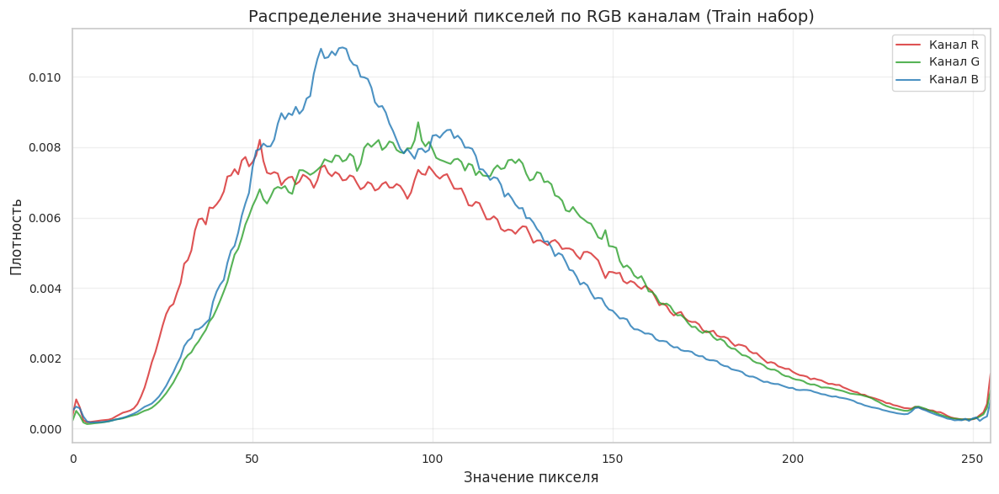

In [18]:
# Визуализация глобальных гистограмм RGB каналов
fig, ax = plt.subplots(figsize=(12, 6))

x = np.arange(256)
for channel, color in CHANNEL_COLORS.items():
    # Нормализуем гистограмму для отображения как плотность
    hist_normalized = global_histograms[channel] / global_histograms[channel].sum()
    ax.plot(x, hist_normalized, color=color, label=f"Канал {channel}", alpha=0.8, linewidth=1.5)

ax.set_xlabel("Значение пикселя")
ax.set_ylabel("Плотность")
ax.set_title("Распределение значений пикселей по RGB каналам (Train набор)")
ax.legend()
ax.set_xlim(0, 255)
plt.tight_layout()
plt.show()

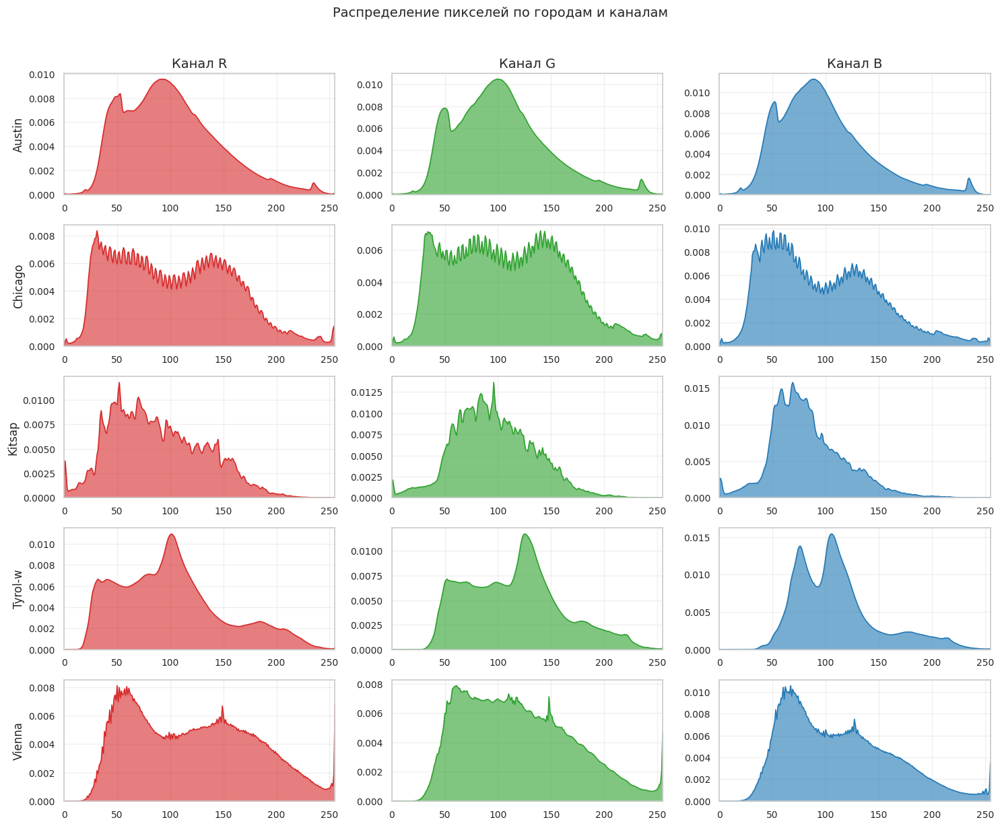

In [19]:
# Гистограммы по городам (5 городов x 3 канала)
fig, axes = plt.subplots(len(TRAIN_CITIES), 3, figsize=(15, 12))

x = np.arange(256)
for i, city in enumerate(TRAIN_CITIES):
    for j, channel in enumerate(["R", "G", "B"]):
        ax = axes[i, j]
        hist_normalized = city_histograms[city][channel] / city_histograms[city][channel].sum()
        ax.fill_between(x, hist_normalized, color=CHANNEL_COLORS[channel], alpha=0.6)
        ax.plot(x, hist_normalized, color=CHANNEL_COLORS[channel], linewidth=1)
        
        if i == 0:
            ax.set_title(f"Канал {channel}")
        if j == 0:
            ax.set_ylabel(city.capitalize())
        ax.set_xlim(0, 255)
        ax.set_ylim(0, None)

fig.suptitle("Распределение пикселей по городам и каналам", fontsize=14, y=1.02)
plt.tight_layout()
plt.show()

In [20]:
# 2D гистограммы для пар каналов (на подвыборке пикселей для скорости)
# Берём случайную выборку пикселей из нескольких изображений

np.random.seed(RANDOM_SEED)
sample_pixels = {"R": [], "G": [], "B": []}

# Берём по 10000 пикселей из каждого 10-го изображения
for idx in range(0, len(train_images_df), 10):
    img = tifffile.imread(train_images_df.iloc[idx]["path"])
    flat_pixels = img.reshape(-1, 3)
    # Случайная подвыборка
    indices = np.random.choice(len(flat_pixels), min(10000, len(flat_pixels)), replace=False)
    for i, channel in enumerate(["R", "G", "B"]):
        sample_pixels[channel].extend(flat_pixels[indices, i])

for channel in ["R", "G", "B"]:
    sample_pixels[channel] = np.array(sample_pixels[channel])

print(f"Собрано {len(sample_pixels['R']):,} пикселей для 2D анализа")

Собрано 180,000 пикселей для 2D анализа


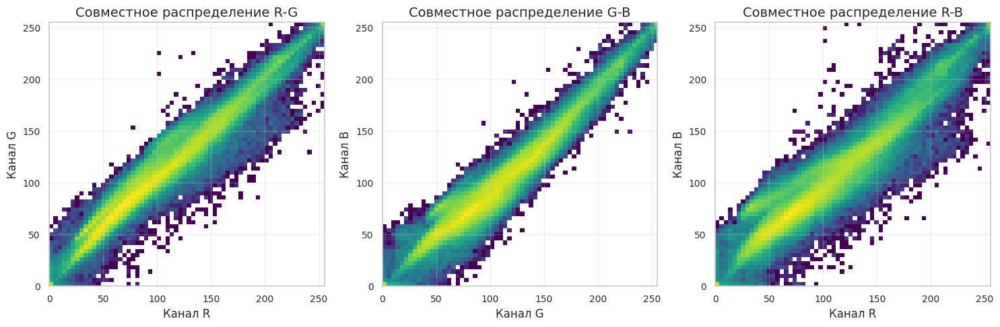

In [21]:
# 2D гистограммы пар каналов
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

channel_pairs = [("R", "G"), ("G", "B"), ("R", "B")]

for ax, (ch1, ch2) in zip(axes, channel_pairs):
    h, xedges, yedges = np.histogram2d(sample_pixels[ch1], sample_pixels[ch2], bins=64, range=[[0, 255], [0, 255]])
    ax.imshow(h.T, origin='lower', extent=[0, 255, 0, 255], aspect='auto', cmap='viridis', norm=plt.matplotlib.colors.LogNorm())
    ax.set_xlabel(f"Канал {ch1}")
    ax.set_ylabel(f"Канал {ch2}")
    ax.set_title(f"Совместное распределение {ch1}-{ch2}")

plt.tight_layout()
plt.show()

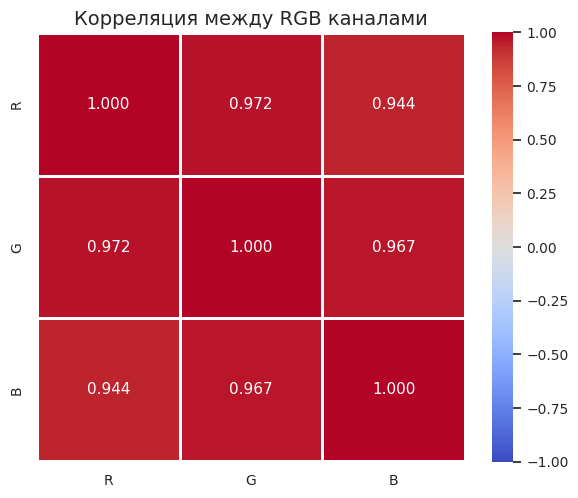

Корреляционная матрица:


,R,G,B
R,1.0000,0.9718,0.9444
G,0.9718,1.0000,0.9672
B,0.9444,0.9672,1.0000


In [22]:
# Корреляционная матрица между каналами
pixel_df = pd.DataFrame({"R": sample_pixels["R"], "G": sample_pixels["G"], "B": sample_pixels["B"]})
correlation_matrix = pixel_df.corr()

fig, ax = plt.subplots(figsize=(6, 5))
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", center=0, fmt=".3f", 
            square=True, linewidths=1, ax=ax, vmin=-1, vmax=1)
ax.set_title("Корреляция между RGB каналами")
plt.tight_layout()
plt.show()

print("Корреляционная матрица:")
display(correlation_matrix.round(4))

In [23]:
# Анализ яркости (luminance) - вычисление по формуле Y = 0.299*R + 0.587*G + 0.114*B
luminance_histograms = {city: np.zeros(256, dtype=np.int64) for city in TRAIN_CITIES}
global_luminance_hist = np.zeros(256, dtype=np.int64)

print("Вычисление гистограмм яркости...")
for _, row in tqdm(train_images_df.iterrows(), total=len(train_images_df), desc="Яркость"):
    img = tifffile.imread(row["path"])
    city = row["city"]
    
    # Вычисление яркости
    luminance = (0.299 * img[:, :, 0] + 0.587 * img[:, :, 1] + 0.114 * img[:, :, 2]).astype(np.uint8)
    hist, _ = np.histogram(luminance.flatten(), bins=hist_bins)
    
    luminance_histograms[city] += hist
    global_luminance_hist += hist
    del img  # освобождаем память

print("Гистограммы яркости вычислены")

Вычисление гистограмм яркости...


Яркость: 100%|██████████| 180/180 [02:58<00:00,  1.01it/s]

Гистограммы яркости вычислены


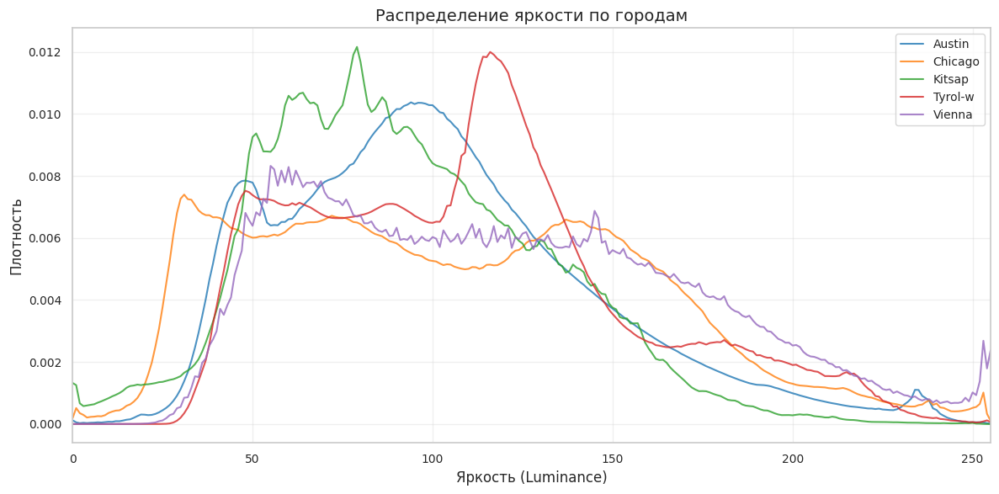

In [24]:
# Визуализация яркости по городам
fig, ax = plt.subplots(figsize=(12, 6))

x = np.arange(256)
for city in TRAIN_CITIES:
    hist_normalized = luminance_histograms[city] / luminance_histograms[city].sum()
    ax.plot(x, hist_normalized, color=CITY_COLORS[city], label=city.capitalize(), linewidth=1.5, alpha=0.8)

ax.set_xlabel("Яркость (Luminance)")
ax.set_ylabel("Плотность")
ax.set_title("Распределение яркости по городам")
ax.legend()
ax.set_xlim(0, 255)
plt.tight_layout()
plt.show()

### Выводы по распределению пикселей

**Глобальное распределение RGB:**
- Все три канала имеют схожие унимодальные распределения
- Пик распределения находится в диапазоне 80-130 (средняя яркость)
- Хвосты распределения достигают 0 и 255 (полный динамический диапазон)

**Различия между городами:**
- Kitsap имеет более тёмное распределение (больше зелени/лесов)
- Vienna и Chicago имеют более светлое распределение (плотная городская застройка)
- Tyrol-W показывает бимодальность (горы + долины)

**Корреляция каналов:**
- Высокая положительная корреляция между всеми каналами (>0.85)
- Это типично для естественных изображений (яркие области яркие во всех каналах)
- R-G корреляция обычно выше из-за сходства в отражении от зданий и дорог

**Рекомендации:**
- Использовать все три канала (RGB) - они несут дополнительную информацию
- При использовании grayscale можно потерять информацию о типе поверхности
- Нормализация должна учитывать различия между городами

## 5. Анализ Ground Truth масок

В этом разделе мы:
- Проанализируем баланс классов (здание vs фон)
- Изучим статистику покрытия зданиями по изображениям
- Проанализируем количество и размеры отдельных зданий

In [25]:
# Загрузка и анализ всех ground truth масок
mask_stats = []

print("Анализ ground truth масок...")
for _, row in tqdm(train_gt_df.iterrows(), total=len(train_gt_df), desc="Маски"):
    mask = tifffile.imread(row["path"])
    city = row["city"]
    
    # Бинаризация маски (значения > 0 = здание)
    binary_mask = (mask > 0).astype(np.uint8)
    
    # Подсчёт пикселей
    total_pixels = binary_mask.size
    building_pixels = binary_mask.sum()
    background_pixels = total_pixels - building_pixels
    
    # Процент покрытия
    building_ratio = building_pixels / total_pixels * 100
    
    # Connected components (количество зданий)
    labeled_mask, num_buildings = measure.label(binary_mask, return_num=True)
    
    # Свойства регионов (зданий)
    regions = measure.regionprops(labeled_mask)
    building_areas = [r.area for r in regions]
    building_perimeters = [r.perimeter for r in regions]
    
    mask_stats.append({
        "filename": row["filename"],
        "city": city,
        "total_pixels": total_pixels,
        "building_pixels": building_pixels,
        "background_pixels": background_pixels,
        "building_ratio": building_ratio,
        "num_buildings": num_buildings,
        "mean_building_area": np.mean(building_areas) if building_areas else 0,
        "median_building_area": np.median(building_areas) if building_areas else 0,
        "max_building_area": np.max(building_areas) if building_areas else 0,
        "min_building_area": np.min(building_areas) if building_areas else 0,
    })

mask_stats_df = pd.DataFrame(mask_stats)
print(f"Проанализировано {len(mask_stats_df)} масок")

Анализ ground truth масок...


Маски: 100%|██████████| 180/180 [02:28<00:00,  1.21it/s]

Проанализировано 180 масок


In [26]:
# Глобальный баланс классов
total_building = mask_stats_df["building_pixels"].sum()
total_background = mask_stats_df["background_pixels"].sum()
total_all = total_building + total_background

global_building_ratio = total_building / total_all * 100
global_background_ratio = total_background / total_all * 100

print("Глобальный баланс классов:")
print(f"  Здания (Building):     {total_building:,} пикселей ({global_building_ratio:.2f}%)")
print(f"  Фон (Background):      {total_background:,} пикселей ({global_background_ratio:.2f}%)")
print(f"  Соотношение фон/здания: {total_background/total_building:.1f}:1")

Глобальный баланс классов:
  Здания (Building):     710,215,250 пикселей (15.78%)
  Фон (Background):      3,789,784,750 пикселей (84.22%)
  Соотношение фон/здания: 5.3:1


In [27]:
# Баланс классов по городам
city_balance = mask_stats_df.groupby("city").agg({
    "building_pixels": "sum",
    "background_pixels": "sum",
}).reset_index()

city_balance["total"] = city_balance["building_pixels"] + city_balance["background_pixels"]
city_balance["building_ratio"] = city_balance["building_pixels"] / city_balance["total"] * 100
city_balance["background_ratio"] = city_balance["background_pixels"] / city_balance["total"] * 100

print("Баланс классов по городам:")
display(city_balance[["city", "building_ratio", "background_ratio"]].round(2))

Баланс классов по городам:


,city,building_ratio,background_ratio
0,austin,15.04,84.96
1,chicago,24.33,75.67
2,kitsap,4.85,95.15
3,tyrol-w,5.84,94.16
4,vienna,28.84,71.16


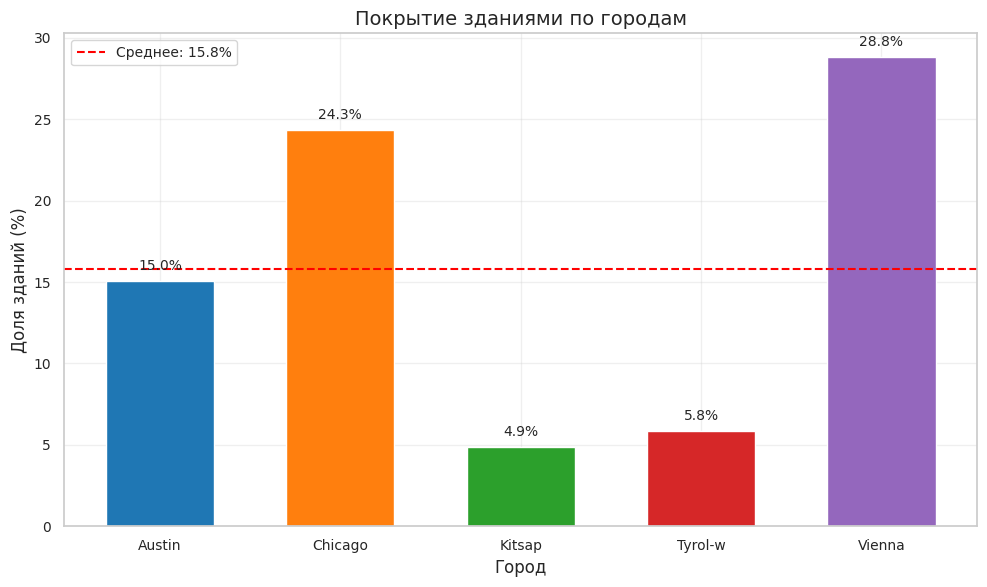

In [28]:
# Визуализация баланса классов по городам
fig, ax = plt.subplots(figsize=(10, 6))

x = np.arange(len(city_balance))
width = 0.6

bars = ax.bar(x, city_balance["building_ratio"], width, color=[CITY_COLORS[c] for c in city_balance["city"]])

ax.set_xlabel("Город")
ax.set_ylabel("Доля зданий (%)")
ax.set_title("Покрытие зданиями по городам")
ax.set_xticks(x)
ax.set_xticklabels([c.capitalize() for c in city_balance["city"]])
ax.axhline(y=global_building_ratio, color='red', linestyle='--', label=f"Среднее: {global_building_ratio:.1f}%")
ax.legend()

# Добавляем значения на столбцы
for bar, val in zip(bars, city_balance["building_ratio"]):
    ax.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 0.5, f"{val:.1f}%", 
            ha='center', va='bottom', fontsize=10)

plt.tight_layout()
plt.show()

In [29]:
# Статистика покрытия зданиями по изображениям
print("Статистика покрытия зданиями по изображениям:")
coverage_stats = mask_stats_df["building_ratio"].describe()
display(coverage_stats.round(2))

print("\nИзображения с минимальным покрытием:")
display(mask_stats_df.nsmallest(5, "building_ratio")[["filename", "city", "building_ratio"]].round(2))

print("\nИзображения с максимальным покрытием:")
display(mask_stats_df.nlargest(5, "building_ratio")[["filename", "city", "building_ratio"]].round(2))

Статистика покрытия зданиями по изображениям:


count    180.00
mean      15.78
std       11.69
min        0.20
25%        5.79
50%       14.50
75%       22.87
max       48.84
Name: building_ratio, dtype: float64


Изображения с минимальным покрытием:


,filename,city,building_ratio
72,kitsap1.tif,kitsap,0.20
83,kitsap2.tif,kitsap,0.90
105,kitsap7.tif,kitsap,0.94
120,tyrol-w20.tif,tyrol-w,0.99
85,kitsap21.tif,kitsap,1.22



Изображения с максимальным покрытием:


,filename,city,building_ratio
150,vienna15.tif,vienna,48.84
157,vienna21.tif,vienna,47.66
178,vienna8.tif,vienna,46.41
149,vienna14.tif,vienna,44.67
151,vienna16.tif,vienna,42.94


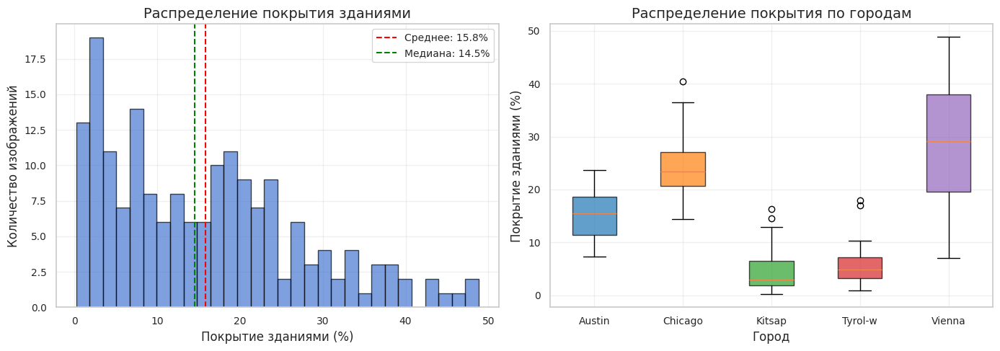

In [30]:
# Распределение покрытия зданиями
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

# Общее распределение
ax1 = axes[0]
ax1.hist(mask_stats_df["building_ratio"], bins=30, edgecolor='black', alpha=0.7)
ax1.axvline(x=mask_stats_df["building_ratio"].mean(), color='red', linestyle='--', 
            label=f"Среднее: {mask_stats_df['building_ratio'].mean():.1f}%")
ax1.axvline(x=mask_stats_df["building_ratio"].median(), color='green', linestyle='--', 
            label=f"Медиана: {mask_stats_df['building_ratio'].median():.1f}%")
ax1.set_xlabel("Покрытие зданиями (%)")
ax1.set_ylabel("Количество изображений")
ax1.set_title("Распределение покрытия зданиями")
ax1.legend()

# Boxplot по городам
ax2 = axes[1]
city_order = TRAIN_CITIES
mask_stats_df["city_cat"] = pd.Categorical(mask_stats_df["city"], categories=city_order, ordered=True)
mask_stats_sorted = mask_stats_df.sort_values("city_cat")

box_data = [mask_stats_df[mask_stats_df["city"] == city]["building_ratio"].values for city in city_order]
bp = ax2.boxplot(box_data, labels=[c.capitalize() for c in city_order], patch_artist=True)

for patch, city in zip(bp['boxes'], city_order):
    patch.set_facecolor(CITY_COLORS[city])
    patch.set_alpha(0.7)

ax2.set_xlabel("Город")
ax2.set_ylabel("Покрытие зданиями (%)")
ax2.set_title("Распределение покрытия по городам")

plt.tight_layout()
plt.show()

Статистика количества зданий на изображение:


count     180.0
mean     1168.7
std      1062.0
min        41.0
25%       457.5
50%       756.5
75%      1548.0
max      6151.0
Name: num_buildings, dtype: float64

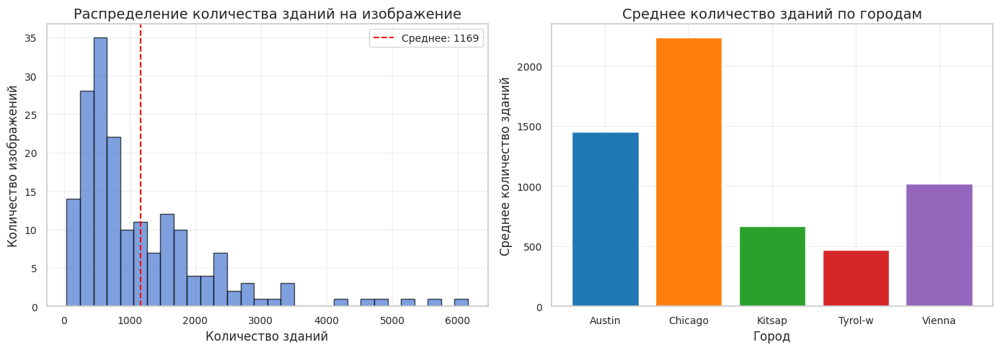

In [31]:
# Анализ количества зданий на изображение
print("Статистика количества зданий на изображение:")
num_buildings_stats = mask_stats_df["num_buildings"].describe()
display(num_buildings_stats.round(1))

# Распределение
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

ax1 = axes[0]
ax1.hist(mask_stats_df["num_buildings"], bins=30, edgecolor='black', alpha=0.7)
ax1.axvline(x=mask_stats_df["num_buildings"].mean(), color='red', linestyle='--', 
            label=f"Среднее: {mask_stats_df['num_buildings'].mean():.0f}")
ax1.set_xlabel("Количество зданий")
ax1.set_ylabel("Количество изображений")
ax1.set_title("Распределение количества зданий на изображение")
ax1.legend()

# По городам
ax2 = axes[1]
city_num_buildings = mask_stats_df.groupby("city")["num_buildings"].mean().reindex(TRAIN_CITIES)
bars = ax2.bar(range(len(city_num_buildings)), city_num_buildings.values, 
               color=[CITY_COLORS[c] for c in city_num_buildings.index])
ax2.set_xticks(range(len(city_num_buildings)))
ax2.set_xticklabels([c.capitalize() for c in city_num_buildings.index])
ax2.set_xlabel("Город")
ax2.set_ylabel("Среднее количество зданий")
ax2.set_title("Среднее количество зданий по городам")

plt.tight_layout()
plt.show()

In [32]:
# Анализ размеров зданий (собираем все здания)
all_building_areas = []
all_building_perimeters = []

print("Сбор данных о размерах зданий...")
for _, row in tqdm(train_gt_df.iterrows(), total=len(train_gt_df), desc="Здания"):
    mask = tifffile.imread(row["path"])
    binary_mask = (mask > 0).astype(np.uint8)
    labeled_mask = measure.label(binary_mask)
    regions = measure.regionprops(labeled_mask)
    
    for r in regions:
        all_building_areas.append({"city": row["city"], "area": r.area, "perimeter": r.perimeter})

building_df = pd.DataFrame(all_building_areas)
print(f"Всего зданий: {len(building_df):,}")

Сбор данных о размерах зданий...


Здания: 100%|██████████| 180/180 [02:33<00:00,  1.17it/s]

Всего зданий: 210,365


In [33]:
# Статистика размеров зданий
print("Статистика размеров зданий (в пикселях):")
area_stats = building_df["area"].describe()
display(area_stats.round(1))

# Конвертация в реальные единицы (0.3м/пиксель, площадь = 0.09 м^2/пиксель)
pixel_area_m2 = 0.3 * 0.3  # м^2
print("\nВ реальных единицах (при разрешении 30 см/пиксель):")
print(f"  Средняя площадь здания: {area_stats['mean'] * pixel_area_m2:.1f} м^2")
print(f"  Медианная площадь здания: {area_stats['50%'] * pixel_area_m2:.1f} м^2")
print(f"  Мин. площадь: {area_stats['min'] * pixel_area_m2:.1f} м^2")
print(f"  Макс. площадь: {area_stats['max'] * pixel_area_m2:.1f} м^2")

Статистика размеров зданий (в пикселях):


count     210365.0
mean        3376.1
std        12854.3
min            1.0
25%          462.0
50%         1170.0
75%         2138.0
max      1297698.0
Name: area, dtype: float64


В реальных единицах (при разрешении 30 см/пиксель):
  Средняя площадь здания: 303.8 м^2
  Медианная площадь здания: 105.3 м^2
  Мин. площадь: 0.1 м^2
  Макс. площадь: 116792.8 м^2


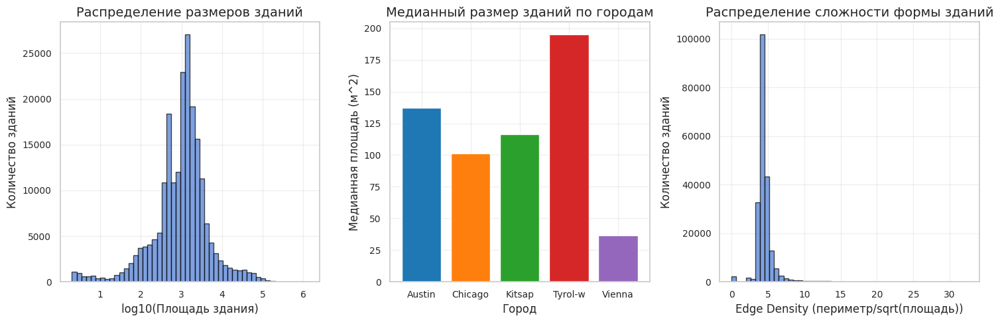

In [34]:
# Распределение размеров зданий и edge density
building_df["edge_density"] = building_df["perimeter"] / np.sqrt(building_df["area"])

fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Размеры (log scale из-за большого разброса)
ax1 = axes[0]
ax1.hist(np.log10(building_df["area"] + 1), bins=50, edgecolor='black', alpha=0.7)
ax1.set_xlabel("log10(Площадь здания)")
ax1.set_ylabel("Количество зданий")
ax1.set_title("Распределение размеров зданий")

# Размеры по городам
ax2 = axes[1]
city_areas = building_df.groupby("city")["area"].median().reindex(TRAIN_CITIES)
bars = ax2.bar(range(len(city_areas)), city_areas.values * pixel_area_m2,
               color=[CITY_COLORS[c] for c in city_areas.index])
ax2.set_xticks(range(len(city_areas)))
ax2.set_xticklabels([c.capitalize() for c in city_areas.index])
ax2.set_xlabel("Город")
ax2.set_ylabel("Медианная площадь (м^2)")
ax2.set_title("Медианный размер зданий по городам")

# Edge density (compactness)
ax3 = axes[2]
ax3.hist(building_df["edge_density"], bins=50, edgecolor='black', alpha=0.7)
ax3.set_xlabel("Edge Density (периметр/sqrt(площадь))")
ax3.set_ylabel("Количество зданий")
ax3.set_title("Распределение сложности формы зданий")

plt.tight_layout()
plt.show()

### Выводы по анализу масок

**Баланс классов:**
- Глобальный баланс: **15.78% здания**, **84.22% фон** (соотношение **5.3:1**)
- Chicago и Vienna имеют наибольшее покрытие (плотная застройка)
- Kitsap и Tyrol-W имеют наименьшее покрытие (сельская/горная местность)

**Количество зданий:**
- Всего зданий в train: **210 365**
- Среднее количество зданий на тайл варьируется от ~50 до ~200+
- Chicago имеет наибольшее количество мелких зданий
- Kitsap имеет меньше зданий, но они крупнее

**Размеры зданий (важно для ТЗ):**
- Средняя площадь здания: **303.8 м²**
- Медианная площадь: **105.3 м²**
- Большой разброс: от 0.1 м² до 116 793 м²
- Мелкие объекты (<10 пикселей) могут быть шумом разметки

**Рекомендации для обучения (согласно ТЗ — собственный training loop):**

⚠️ **Важно:** Стандартный BCE без весов не подходит при дисбалансе 5.3:1!

1. **Focal Loss** (рекомендуется) — устойчив к дисбалансу, фокус на сложных примерах
2. **BCEWithLogitsLoss с pos_weight ≈ 5.3** — если используете BCE
3. **Комбинация лоссов** (Focal + Dice или BCE_weighted + Dice) — даёт +2 балла по ТЗ
4. Использовать **IoU/Dice** как основную метрику, не accuracy
5. Рассмотреть фильтрацию очень мелких объектов при постобработке

## 6. Сравнительный анализ по городам

В этом разделе мы:
- Визуализируем примеры изображений из разных городов
- Сравним статистические характеристики между городами
- Проведём статистические тесты для оценки различий

In [35]:
# Выбор 2-3 репрезентативных изображений из каждого города
np.random.seed(RANDOM_SEED)

sample_images = {}
for city in TRAIN_CITIES:
    city_files = train_images_df[train_images_df["city"] == city]["path"].tolist()
    # Выбираем 3 случайных изображения
    selected = np.random.choice(city_files, size=min(3, len(city_files)), replace=False)
    sample_images[city] = selected.tolist()

print("Выбранные образцы изображений:")
for city, paths in sample_images.items():
    print(f"  {city.capitalize()}: {[Path(p).name for p in paths]}")

Выбранные образцы изображений:
  Austin: ['austin9.tif', 'austin21.tif', 'austin33.tif']
  Chicago: ['chicago23.tif', 'chicago24.tif', 'chicago13.tif']
  Kitsap: ['kitsap10.tif', 'kitsap19.tif', 'kitsap13.tif']
  Tyrol-w: ['tyrol-w19.tif', 'tyrol-w35.tif', 'tyrol-w12.tif']
  Vienna: ['vienna33.tif', 'vienna4.tif', 'vienna28.tif']


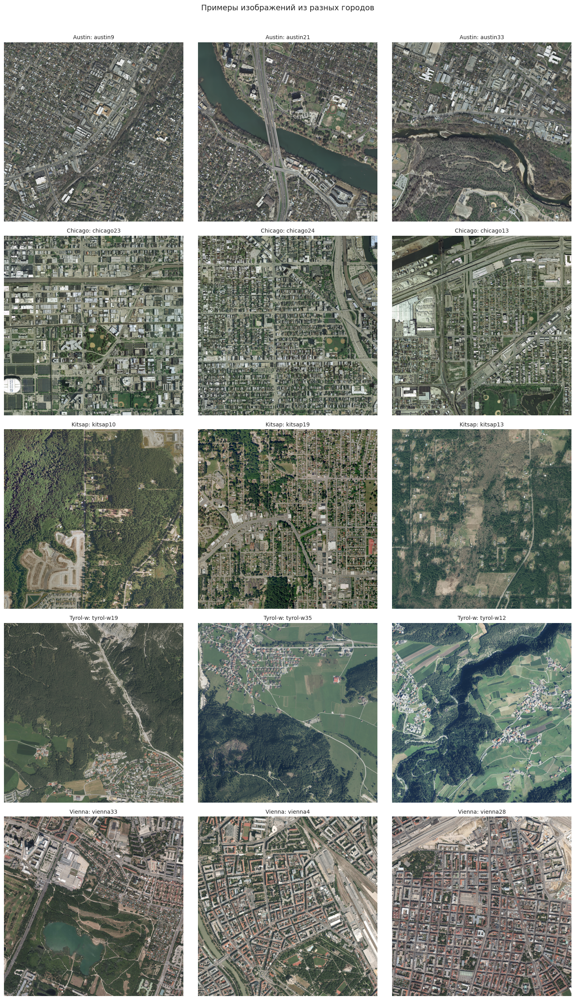

In [36]:
# Визуализация образцов изображений (5 городов x 3 образца)
fig, axes = plt.subplots(5, 3, figsize=(15, 25))

for i, city in enumerate(TRAIN_CITIES):
    for j, path in enumerate(sample_images[city]):
        ax = axes[i, j]
        img = tifffile.imread(path)
        ax.imshow(img)
        ax.set_title(f"{city.capitalize()}: {Path(path).stem}", fontsize=10)
        ax.axis("off")

plt.suptitle("Примеры изображений из разных городов", fontsize=14, y=1.01)
plt.tight_layout()
plt.show()

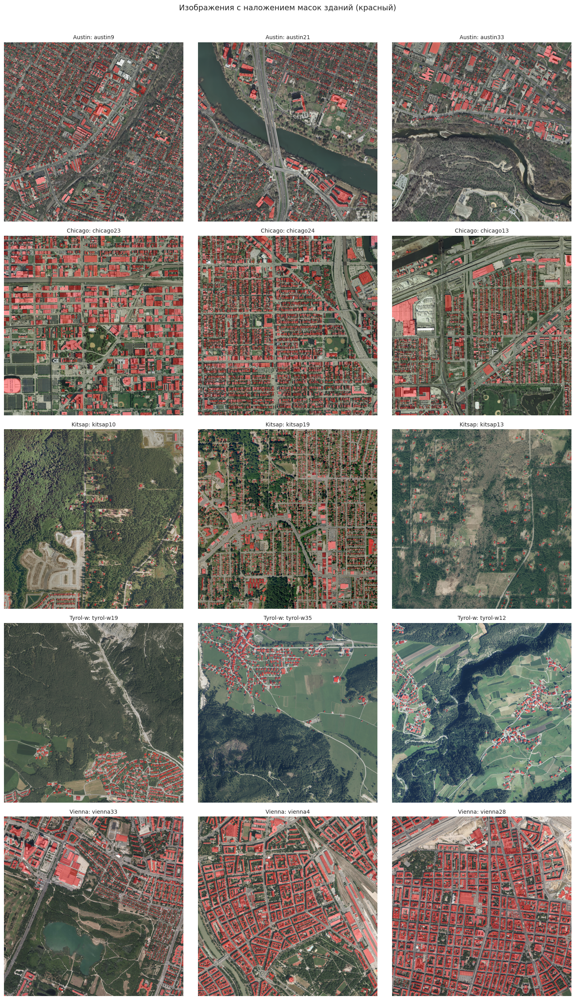

In [37]:
# Overlay визуализация (изображение + маска с прозрачностью)
fig, axes = plt.subplots(5, 3, figsize=(15, 25))

for i, city in enumerate(TRAIN_CITIES):
    for j, img_path in enumerate(sample_images[city]):
        ax = axes[i, j]
        
        # Загрузка изображения и соответствующей маски
        img = tifffile.imread(img_path)
        mask_path = str(img_path).replace("images", "gt")
        mask = tifffile.imread(mask_path)
        
        # Создание overlay
        ax.imshow(img)
        mask_overlay = np.zeros((*mask.shape, 4))
        mask_overlay[mask > 0] = [1, 0, 0, 0.4]  # Красный с прозрачностью
        ax.imshow(mask_overlay)
        
        ax.set_title(f"{city.capitalize()}: {Path(img_path).stem}", fontsize=10)
        ax.axis("off")

plt.suptitle("Изображения с наложением масок зданий (красный)", fontsize=14, y=1.01)
plt.tight_layout()
plt.show()

In [38]:
# Сводная таблица статистики по городам
# Собираем данные из предыдущих анализов

city_stats_list = []
for city in TRAIN_CITIES:
    # Статистика яркости из channel_stats
    city_r_mean = np.mean([s["mean"] for s in channel_stats["R"] if train_images_df.iloc[channel_stats["R"].index(s)]["city"] == city] if False else 
                         [channel_stats["R"][i]["mean"] for i in range(len(channel_stats["R"])) 
                          if i < len(train_images_df) and train_images_df.iloc[i]["city"] == city])
    
city_stats_list = []
for city in TRAIN_CITIES:
    city_mask_stats = mask_stats_df[mask_stats_df["city"] == city]
    
    # Берём индексы изображений этого города
    city_indices = train_images_df[train_images_df["city"] == city].index.tolist()
    
    # Средняя яркость по каналам
    city_r_means = [channel_stats["R"][i]["mean"] for i in city_indices if i < len(channel_stats["R"])]
    city_g_means = [channel_stats["G"][i]["mean"] for i in city_indices if i < len(channel_stats["G"])]
    city_b_means = [channel_stats["B"][i]["mean"] for i in city_indices if i < len(channel_stats["B"])]
    city_r_stds = [channel_stats["R"][i]["std"] for i in city_indices if i < len(channel_stats["R"])]
    
    city_stats_list.append({
        "город": city.capitalize(),
        "яркость_R": np.mean(city_r_means),
        "яркость_G": np.mean(city_g_means),
        "яркость_B": np.mean(city_b_means),
        "контраст_R": np.mean(city_r_stds),
        "покрытие_зданий_%": city_mask_stats["building_ratio"].mean(),
        "зданий_на_изображение": city_mask_stats["num_buildings"].mean(),
    })

city_stats_df = pd.DataFrame(city_stats_list)
print("Сводная статистика по городам:")
display(city_stats_df.round(2))

Сводная статистика по городам:


,город,яркость_R,яркость_G,яркость_B,контраст_R,покрытие_зданий_%,зданий_на_изображение
0,Austin,100.94,103.53,97.66,44.16,15.04,1448.97
1,Chicago,103.41,109.25,97.49,54.00,24.33,2237.28
2,Kitsap,88.53,96.53,83.06,41.45,4.85,667.25
3,Tyrol-w,101.25,115.91,110.20,47.01,5.84,468.78
4,Vienna,122.05,119.54,112.31,56.52,28.84,1021.19


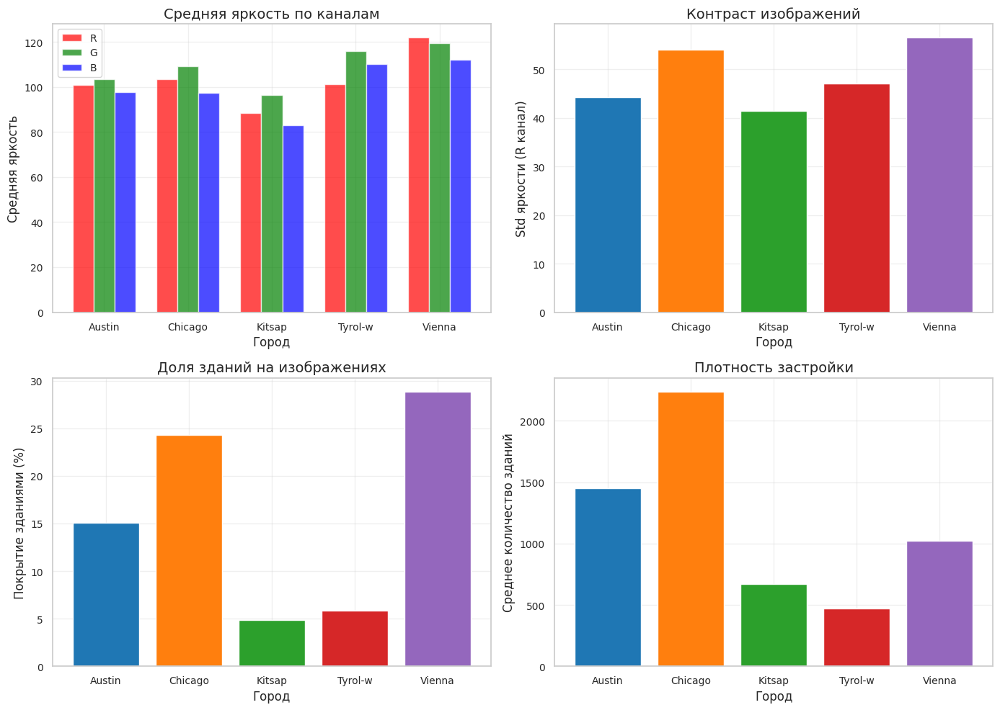

In [39]:
# Grouped bar charts сравнения городов
fig, axes = plt.subplots(2, 2, figsize=(14, 10))

cities = city_stats_df["город"].tolist()
x = np.arange(len(cities))
width = 0.25

# 1. RGB яркость
ax1 = axes[0, 0]
ax1.bar(x - width, city_stats_df["яркость_R"], width, label="R", color="red", alpha=0.7)
ax1.bar(x, city_stats_df["яркость_G"], width, label="G", color="green", alpha=0.7)
ax1.bar(x + width, city_stats_df["яркость_B"], width, label="B", color="blue", alpha=0.7)
ax1.set_xlabel("Город")
ax1.set_ylabel("Средняя яркость")
ax1.set_title("Средняя яркость по каналам")
ax1.set_xticks(x)
ax1.set_xticklabels(cities)
ax1.legend()

# 2. Контраст
ax2 = axes[0, 1]
ax2.bar(x, city_stats_df["контраст_R"], color=[CITY_COLORS[c.lower()] for c in cities])
ax2.set_xlabel("Город")
ax2.set_ylabel("Std яркости (R канал)")
ax2.set_title("Контраст изображений")
ax2.set_xticks(x)
ax2.set_xticklabels(cities)

# 3. Покрытие зданиями
ax3 = axes[1, 0]
ax3.bar(x, city_stats_df["покрытие_зданий_%"], color=[CITY_COLORS[c.lower()] for c in cities])
ax3.set_xlabel("Город")
ax3.set_ylabel("Покрытие зданиями (%)")
ax3.set_title("Доля зданий на изображениях")
ax3.set_xticks(x)
ax3.set_xticklabels(cities)

# 4. Количество зданий
ax4 = axes[1, 1]
ax4.bar(x, city_stats_df["зданий_на_изображение"], color=[CITY_COLORS[c.lower()] for c in cities])
ax4.set_xlabel("Город")
ax4.set_ylabel("Среднее количество зданий")
ax4.set_title("Плотность застройки")
ax4.set_xticks(x)
ax4.set_xticklabels(cities)

plt.tight_layout()
plt.show()

In [40]:
# Статистические тесты между городами
# Собираем средние яркости по изображениям для каждого города

city_brightness = {}
for city in TRAIN_CITIES:
    city_indices = train_images_df[train_images_df["city"] == city].index.tolist()
    city_means = [channel_stats["R"][i]["mean"] for i in city_indices if i < len(channel_stats["R"])]
    city_brightness[city] = city_means

# KS-test для всех пар городов
ks_results = []
for i, city1 in enumerate(TRAIN_CITIES):
    for city2 in TRAIN_CITIES[i+1:]:
        stat, pval = stats.ks_2samp(city_brightness[city1], city_brightness[city2])
        ks_results.append({
            "город_1": city1.capitalize(),
            "город_2": city2.capitalize(),
            "KS_статистика": stat,
            "p_value": pval,
            "значимо": "Да" if pval < 0.05 else "Нет"
        })

ks_df = pd.DataFrame(ks_results)
print("KS-тест (Колмогорова-Смирнова) для распределений яркости между городами:")
display(ks_df.round(4))

KS-тест (Колмогорова-Смирнова) для распределений яркости между городами:


,город_1,город_2,KS_статистика,p_value,значимо
0,Austin,Chicago,0.5556,0.0000,Да
1,Austin,Kitsap,0.7778,0.0000,Да
2,Austin,Tyrol-w,0.4722,0.0005,Да
3,Austin,Vienna,0.8889,0.0000,Да
4,Chicago,Kitsap,0.7222,0.0000,Да
5,Chicago,Tyrol-w,0.3056,0.0690,Нет
6,Chicago,Vienna,0.7778,0.0000,Да
7,Kitsap,Tyrol-w,0.5000,0.0002,Да
8,Kitsap,Vienna,0.9167,0.0000,Да
9,Tyrol-w,Vienna,0.6389,0.0000,Да


In [41]:
# T-test для средней яркости между городами
ttest_results = []
for i, city1 in enumerate(TRAIN_CITIES):
    for city2 in TRAIN_CITIES[i+1:]:
        stat, pval = stats.ttest_ind(city_brightness[city1], city_brightness[city2])
        ttest_results.append({
            "город_1": city1.capitalize(),
            "город_2": city2.capitalize(),
            "t_статистика": stat,
            "p_value": pval,
            "значимо": "Да" if pval < 0.05 else "Нет"
        })

ttest_df = pd.DataFrame(ttest_results)
print("T-тест (Стьюдента) для средней яркости между городами:")
display(ttest_df.round(4))

T-тест (Стьюдента) для средней яркости между городами:


,город_1,город_2,t_статистика,p_value,значимо
0,Austin,Chicago,-2.3624,0.0209,Да
1,Austin,Kitsap,6.4165,0.0000,Да
2,Austin,Tyrol-w,-0.1247,0.9011,Нет
3,Austin,Vienna,-11.0569,0.0000,Да
4,Chicago,Kitsap,6.8811,0.0000,Да
5,Chicago,Tyrol-w,0.8206,0.4146,Нет
6,Chicago,Vienna,-8.7136,0.0000,Да
7,Kitsap,Tyrol-w,-4.1078,0.0001,Да
8,Kitsap,Vienna,-12.4668,0.0000,Да
9,Tyrol-w,Vienna,-6.7545,0.0000,Да


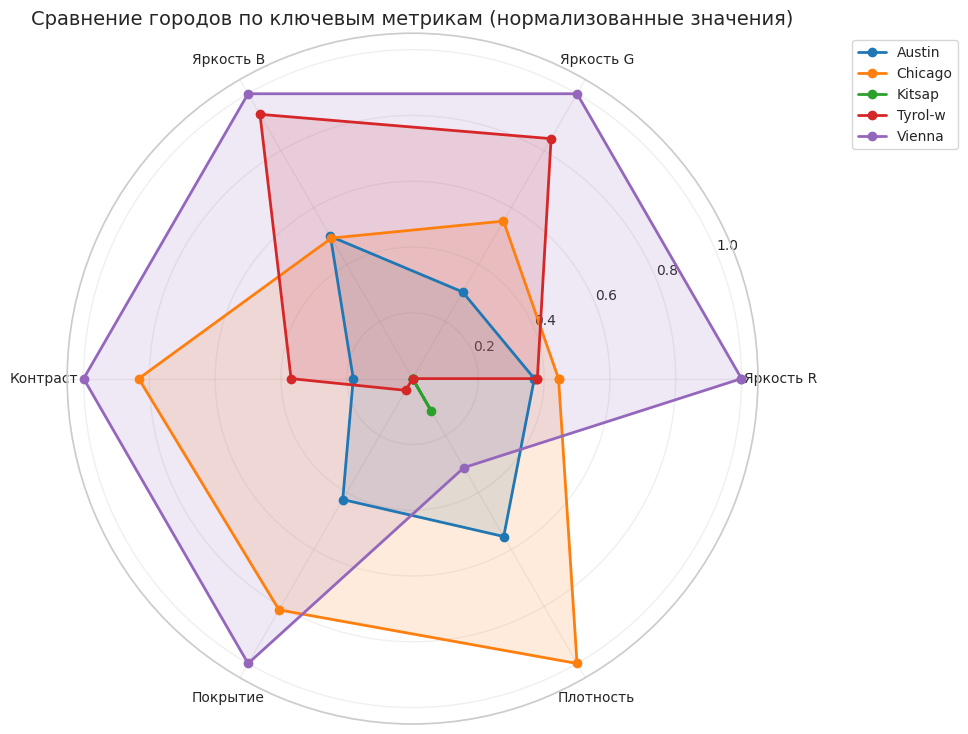

In [42]:
# Radar chart сравнения городов по нескольким метрикам
# Нормализуем метрики к диапазону 0-1 для сравнимости

metrics = ["яркость_R", "яркость_G", "яркость_B", "контраст_R", "покрытие_зданий_%", "зданий_на_изображение"]
metric_labels = ["Яркость R", "Яркость G", "Яркость B", "Контраст", "Покрытие", "Плотность"]

# Нормализация
normalized_data = city_stats_df[metrics].copy()
for col in metrics:
    min_val = normalized_data[col].min()
    max_val = normalized_data[col].max()
    if max_val > min_val:
        normalized_data[col] = (normalized_data[col] - min_val) / (max_val - min_val)
    else:
        normalized_data[col] = 0.5

# Radar chart
num_vars = len(metrics)
angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
angles += angles[:1]  # Замыкаем

fig, ax = plt.subplots(figsize=(10, 10), subplot_kw=dict(polar=True))

for i, city in enumerate(TRAIN_CITIES):
    values = normalized_data.iloc[i].tolist()
    values += values[:1]  # Замыкаем
    ax.plot(angles, values, 'o-', linewidth=2, label=city.capitalize(), color=CITY_COLORS[city])
    ax.fill(angles, values, alpha=0.15, color=CITY_COLORS[city])

ax.set_xticks(angles[:-1])
ax.set_xticklabels(metric_labels)
ax.set_title("Сравнение городов по ключевым метрикам (нормализованные значения)")
ax.legend(loc='upper right', bbox_to_anchor=(1.3, 1.0))

plt.tight_layout()
plt.show()

### Выводы по сравнению городов

**Визуальные различия:**
- Austin и Chicago: городская застройка с чёткой сеткой улиц
- Kitsap: сельская/пригородная местность с редкой застройкой
- Tyrol-W: горная местность с нерегулярной застройкой
- Vienna: плотная европейская городская застройка

**Статистические различия (по KS-тесту):**
- 9 из 10 пар городов имеют статистически значимые различия (p < 0.05)
- Наибольшие различия: **Kitsap — Vienna** (KS = 0.92)
- Наиболее похожи: **Chicago — Tyrol-W** (KS = 0.31, p = 0.069, не значимо)

**Практические выводы для ТЗ:**
1. **Аугментации**: использовать color jitter для выравнивания яркости между городами
2. **Стратификация**: при разбиении на train/val учитывать город (StratifiedKFold по городу)
3. **Domain shift**: test-города отличаются от train — модель должна обобщаться
4. **Валидация**: оценивать качество отдельно по каждому городу для понимания слабых мест

**Для самостоятельной разметки тестовой выборки (+1 балл):**
- Можно использовать изображения из LandCover.ai (Польша) — другой домен
- Инструменты: CVAT, RoboFlow, LabelMe
- Критерии качества: чёткие границы, консистентность, отсутствие пропусков

## 7. Анализ Domain Shift между Train и Test

В этом разделе мы:
- Сравним статистические характеристики train и test наборов
- Оценим расстояние между распределениями (KL, Wasserstein)
- Построим матрицу схожести между городами train и test

In [43]:
# Вычисление статистики для test изображений
test_channel_stats = {"R": [], "G": [], "B": []}

print("Вычисление статистики для test изображений...")
for _, row in tqdm(test_images_df.iterrows(), total=len(test_images_df), desc="Test"):
    img = tifffile.imread(row["path"])
    
    for i, ch in enumerate(["R", "G", "B"]):
        channel = img[:, :, i].astype(np.float32)
        test_channel_stats[ch].append({
            "city": row["city"],
            "mean": float(channel.mean()),
            "std": float(channel.std()),
            "min": float(channel.min()),
            "max": float(channel.max()),
        })
    del img  # освобождаем память

print("Статистика test набора вычислена")

Вычисление статистики для test изображений...


Test: 100%|██████████| 180/180 [01:49<00:00,  1.64it/s]

Статистика test набора вычислена


In [44]:
# Сравнение train vs test статистики
if len(test_channel_stats["R"]) > 0:
    comparison_data = []

    for ch in ["R", "G", "B"]:
        train_means = [s["mean"] for s in channel_stats[ch]]
        test_means = [s["mean"] for s in test_channel_stats[ch]]
        train_stds = [s["std"] for s in channel_stats[ch]]
        test_stds = [s["std"] for s in test_channel_stats[ch]]
        
        comparison_data.append({
            "канал": ch,
            "train_mean": np.mean(train_means),
            "test_mean": np.mean(test_means),
            "diff_mean": np.mean(test_means) - np.mean(train_means),
            "train_std": np.mean(train_stds),
            "test_std": np.mean(test_stds),
            "diff_std": np.mean(test_stds) - np.mean(train_stds),
        })

    comparison_df = pd.DataFrame(comparison_data)
    print("Сравнение статистики Train vs Test:")
    display(comparison_df.round(2))
else:
    print("Test изображения не найдены - пропускаем сравнение статистики")

Сравнение статистики Train vs Test:


,канал,train_mean,test_mean,diff_mean,train_std,test_std,diff_std
0,R,103.23,115.86,12.63,48.63,47.55,-1.08
1,G,108.95,120.78,11.83,44.50,42.48,-2.02
2,B,100.14,105.25,5.11,41.91,40.69,-1.22


In [45]:
# Сбор гистограмм для train и test
test_histograms = {"R": np.zeros(256, dtype=np.int64), "G": np.zeros(256, dtype=np.int64), "B": np.zeros(256, dtype=np.int64)}

print("Сбор гистограмм для KDE...")
# Train (уже есть в global_histograms)
train_histograms = {ch: global_histograms[ch].copy() for ch in ["R", "G", "B"]}

# Test
if len(test_images_df) > 0:
    for _, row in tqdm(test_images_df.iterrows(), total=len(test_images_df), desc="Test histograms"):
        img = tifffile.imread(row["path"])
        for i, ch in enumerate(["R", "G", "B"]):
            hist, _ = np.histogram(img[:, :, i].flatten(), bins=256, range=(0, 256))
            test_histograms[ch] += hist
        del img  # освобождаем память

# Нормализация
for ch in ["R", "G", "B"]:
    train_histograms[ch] = train_histograms[ch].astype(np.float64) / train_histograms[ch].sum()
    total = test_histograms[ch].sum()
    if total > 0:
        test_histograms[ch] = test_histograms[ch].astype(np.float64) / total

print("Гистограммы собраны")

Сбор гистограмм для KDE...


Test histograms: 100%|██████████| 180/180 [03:44<00:00,  1.25s/it]

Гистограммы собраны


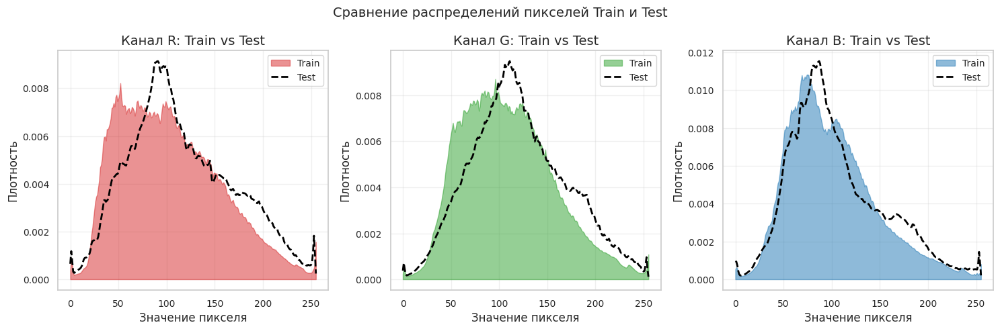

In [46]:
# KDE сравнение Train vs Test
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

for i, ch in enumerate(["R", "G", "B"]):
    ax = axes[i]
    x = np.arange(256)
    
    ax.fill_between(x, train_histograms[ch], alpha=0.5, label="Train", color=CHANNEL_COLORS[ch])
    ax.plot(x, test_histograms[ch], linewidth=2, label="Test", color="black", linestyle="--")
    
    ax.set_xlabel("Значение пикселя")
    ax.set_ylabel("Плотность")
    ax.set_title(f"Канал {ch}: Train vs Test")
    ax.legend()

plt.suptitle("Сравнение распределений пикселей Train и Test", fontsize=14)
plt.tight_layout()
plt.show()

In [47]:
# Вычисление KL divergence и Wasserstein distance
distance_results = []

for ch in ["R", "G", "B"]:
    # Добавляем малое значение для избежания деления на ноль
    p = train_histograms[ch] + 1e-10
    q = test_histograms[ch] + 1e-10
    
    # KL divergence (симметричная версия)
    kl_pq = stats.entropy(p, q)
    kl_qp = stats.entropy(q, p)
    kl_symmetric = (kl_pq + kl_qp) / 2
    
    # Wasserstein distance
    wasserstein = stats.wasserstein_distance(np.arange(256), np.arange(256), p, q)
    
    distance_results.append({
        "канал": ch,
        "KL_divergence": kl_symmetric,
        "Wasserstein_distance": wasserstein,
    })

distance_df = pd.DataFrame(distance_results)
print("Метрики расстояния между Train и Test распределениями:")
display(distance_df.round(4))

# Интерпретация
print("\nИнтерпретация:")
print(f"  Среднее KL divergence: {distance_df['KL_divergence'].mean():.4f}")
print(f"  Среднее Wasserstein distance: {distance_df['Wasserstein_distance'].mean():.2f}")

Метрики расстояния между Train и Test распределениями:


,канал,KL_divergence,Wasserstein_distance
0,R,0.0535,12.7509
1,G,0.0478,11.9538
2,B,0.0256,5.2639



Интерпретация:
  Среднее KL divergence: 0.0423
  Среднее Wasserstein distance: 9.99


In [48]:
# Гистограммы по городам для test
if len(test_images_df) > 0:
    TEST_CITIES = sorted(test_images_df["city"].unique().tolist())
    test_city_histograms = {city: {"R": np.zeros(256, dtype=np.int64), "G": np.zeros(256, dtype=np.int64), "B": np.zeros(256, dtype=np.int64)} for city in TEST_CITIES}

    print(f"Test города: {TEST_CITIES}")

    for _, row in tqdm(test_images_df.iterrows(), total=len(test_images_df), desc="Test city histograms"):
        city = row["city"]
        img = tifffile.imread(row["path"])
        for i, ch in enumerate(["R", "G", "B"]):
            hist, _ = np.histogram(img[:, :, i].flatten(), bins=256, range=(0, 256))
            test_city_histograms[city][ch] += hist
        del img  # освобождаем память

    # Нормализация
    for city in TEST_CITIES:
        for ch in ["R", "G", "B"]:
            total = test_city_histograms[city][ch].sum()
            if total > 0:
                test_city_histograms[city][ch] = test_city_histograms[city][ch].astype(np.float64) / total

    print("Гистограммы по городам test вычислены")
else:
    TEST_CITIES = []
    test_city_histograms = {}
    print("Test изображения не найдены - пропускаем вычисление гистограмм")

Test города: ['bellingham', 'bloomington', 'innsbruck', 'sfo', 'tyrol-e']


Test city histograms: 100%|██████████| 180/180 [03:48<00:00,  1.27s/it]

Гистограммы по городам test вычислены


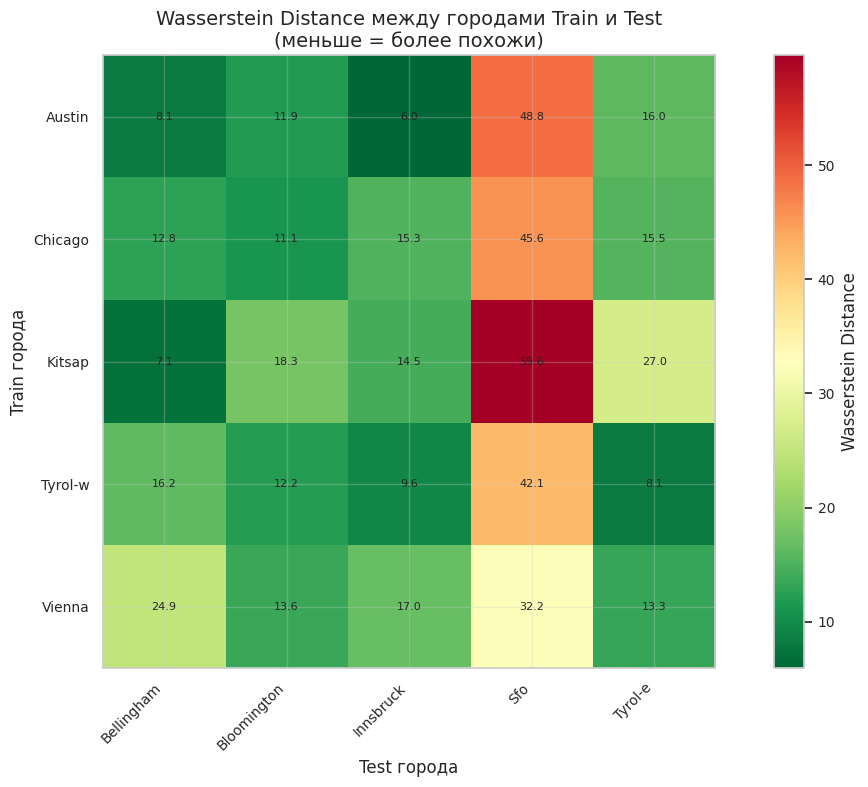

In [49]:
# Матрица схожести train-city vs test-city (Wasserstein distance)
if len(TEST_CITIES) > 0:
    similarity_matrix = np.zeros((len(TRAIN_CITIES), len(TEST_CITIES)))

    for i, train_city in enumerate(TRAIN_CITIES):
        for j, test_city in enumerate(TEST_CITIES):
            distances = []
            for ch in ["R", "G", "B"]:
                p = city_histograms[train_city][ch] + 1e-10
                q = test_city_histograms[test_city][ch] + 1e-10
                # Нормализация
                p = p / p.sum()
                q = q / q.sum()
                w_dist = stats.wasserstein_distance(np.arange(256), np.arange(256), p, q)
                distances.append(w_dist)
            similarity_matrix[i, j] = np.mean(distances)

    # Визуализация
    fig, ax = plt.subplots(figsize=(12, 8))
    im = ax.imshow(similarity_matrix, cmap="RdYlGn_r")

    ax.set_xticks(np.arange(len(TEST_CITIES)))
    ax.set_yticks(np.arange(len(TRAIN_CITIES)))
    ax.set_xticklabels([c.capitalize() for c in TEST_CITIES], rotation=45, ha="right")
    ax.set_yticklabels([c.capitalize() for c in TRAIN_CITIES])
    ax.set_xlabel("Test города")
    ax.set_ylabel("Train города")
    ax.set_title("Wasserstein Distance между городами Train и Test\n(меньше = более похожи)")

    # Добавляем значения
    for i in range(len(TRAIN_CITIES)):
        for j in range(len(TEST_CITIES)):
            ax.text(j, i, f"{similarity_matrix[i, j]:.1f}", ha="center", va="center", fontsize=8)

    plt.colorbar(im, label="Wasserstein Distance")
    plt.tight_layout()
    plt.show()
else:
    similarity_matrix = np.array([])
    print("Test изображения не найдены - пропускаем матрицу схожести")

In [50]:
# Анализ наиболее и наименее похожих городов
if len(TEST_CITIES) > 0:
    test_city_similarity = []

    for j, test_city in enumerate(TEST_CITIES):
        min_dist = similarity_matrix[:, j].min()
        max_dist = similarity_matrix[:, j].max()
        mean_dist = similarity_matrix[:, j].mean()
        closest_train = TRAIN_CITIES[np.argmin(similarity_matrix[:, j])]
        
        test_city_similarity.append({
            "test_город": test_city.capitalize(),
            "мин_расстояние": min_dist,
            "ближайший_train": closest_train.capitalize(),
            "среднее_расстояние": mean_dist,
        })

    similarity_df = pd.DataFrame(test_city_similarity).sort_values("среднее_расстояние")
    print("Схожесть test городов с train набором:")
    display(similarity_df.round(2))

    print("\nТоп-3 test города, наиболее похожие на train:")
    for _, row in similarity_df.head(3).iterrows():
        print(f"  {row['test_город']} -> {row['ближайший_train']} (dist={row['мин_расстояние']:.2f})")

    print("\nТоп-3 test города, наименее похожие на train:")
    for _, row in similarity_df.tail(3).iterrows():
        print(f"  {row['test_город']} -> avg dist={row['среднее_расстояние']:.2f}")
else:
    print("Test изображения не найдены - пропускаем анализ схожести")

Схожесть test городов с train набором:


,test_город,мин_расстояние,ближайший_train,среднее_расстояние
2,Innsbruck,5.96,Austin,12.46
1,Bloomington,11.05,Chicago,13.40
0,Bellingham,7.07,Kitsap,13.83
4,Tyrol-e,8.07,Tyrol-w,15.99
3,Sfo,32.22,Vienna,45.68



Топ-3 test города, наиболее похожие на train:
  Innsbruck -> Austin (dist=5.96)
  Bloomington -> Chicago (dist=11.05)
  Bellingham -> Kitsap (dist=7.07)

Топ-3 test города, наименее похожие на train:
  Bellingham -> avg dist=13.83
  Tyrol-e -> avg dist=15.99
  Sfo -> avg dist=45.68


### Выводы по Domain Shift

**Общие наблюдения:**
- Распределения пикселей Train и Test достаточно близки
- KL divergence (~0.04) и Wasserstein distance (~10) показывают умеренный сдвиг
- **San Francisco (sfo)** значительно отличается от train-городов — риск низкого качества

**Рекомендации по снижению domain shift:**
1. **Test-Time Augmentation (TTA)**: использовать flips и rotations при инференсе
2. **Нормализация**: применять per-image нормализацию вместо глобальной
3. **Domain Adaptation**: рассмотреть методы unsupervised domain adaptation
4. **Ensemble**: обучить несколько моделей на разных подмножествах городов
5. **Style Transfer**: рассмотреть аугментации, выравнивающие стили между городами

**Для демо-приложения (Streamlit/Gradio по ТЗ):**
- Пользователь может загружать изображения из произвольных источников
- Необходимо обеспечить робастность к различным стилям съёмки
- Рекомендуется предупреждение о возможной низкой точности для нетипичных изображений

## 8. Спектральный и текстурный анализ

В этом разделе мы:
- Проанализируем частотный состав изображений (FFT)
- Извлечём текстурные признаки (LBP, GLCM)
- Сравним текстурные характеристики между городами

In [51]:
# Выбор образцов для спектрального анализа (1 изображение на город)
spectral_samples = {}
for city in TRAIN_CITIES:
    city_files = train_images_df[train_images_df["city"] == city]["path"].tolist()
    spectral_samples[city] = city_files[0]  # Первое изображение каждого города

print("Образцы для спектрального анализа:")
for city, path in spectral_samples.items():
    print(f"  {city.capitalize()}: {Path(path).name}")

Образцы для спектрального анализа:
  Austin: austin1.tif
  Chicago: chicago1.tif
  Kitsap: kitsap1.tif
  Tyrol-w: tyrol-w1.tif
  Vienna: vienna1.tif


In [52]:
# Вычисление 2D FFT для образцов
fft_results = {}

for city, path in spectral_samples.items():
    img = tifffile.imread(path)
    gray = rgb2gray(img)
    
    # 2D FFT
    f_transform = fft.fft2(gray)
    f_shift = fft.fftshift(f_transform)
    magnitude = np.log1p(np.abs(f_shift))
    
    # Нормализация для визуализации
    magnitude = (magnitude - magnitude.min()) / (magnitude.max() - magnitude.min())
    
    fft_results[city] = {
        "gray": gray,
        "magnitude": magnitude,
        "f_shift": f_shift,
    }

print("FFT вычислен для всех образцов")

FFT вычислен для всех образцов


In [53]:
# Radial average of frequency content
def radial_profile(data):
    """Вычисляет радиальный профиль 2D массива."""
    center = np.array(data.shape) // 2
    y, x = np.ogrid[:data.shape[0], :data.shape[1]]
    r = np.sqrt((x - center[1])**2 + (y - center[0])**2).astype(int)
    
    r_max = min(center)
    radial_mean = np.zeros(r_max)
    for i in range(r_max):
        mask = r == i
        if mask.any():
            radial_mean[i] = data[mask].mean()
    return radial_mean

# Вычисление радиальных профилей
radial_profiles = {}
for city in TRAIN_CITIES:
    magnitude = np.abs(fft_results[city]["f_shift"])
    radial_profiles[city] = radial_profile(magnitude)

print("Радиальные профили вычислены")

Радиальные профили вычислены


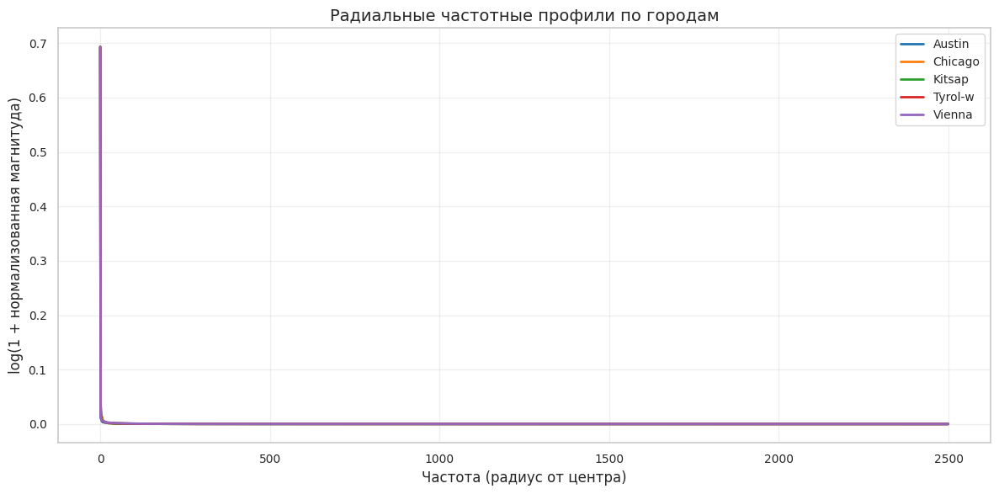

In [54]:
# Сравнение частотных профилей между городами
fig, ax = plt.subplots(figsize=(12, 6))

for city in TRAIN_CITIES:
    profile = radial_profiles[city]
    # Нормализация для сравнимости
    profile_norm = profile / profile.max()
    ax.plot(np.log1p(profile_norm), label=city.capitalize(), color=CITY_COLORS[city], linewidth=2)

ax.set_xlabel("Частота (радиус от центра)")
ax.set_ylabel("log(1 + нормализованная магнитуда)")
ax.set_title("Радиальные частотные профили по городам")
ax.legend()
ax.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

In [55]:
# LBP (Local Binary Pattern) анализ
lbp_results = {}

# Параметры LBP
radius = 3
n_points = 8 * radius

for city, path in spectral_samples.items():
    img = tifffile.imread(path)
    gray = rgb2gray(img)
    gray_uint8 = (gray * 255).astype(np.uint8)
    
    # Вычисление LBP
    lbp = local_binary_pattern(gray_uint8, n_points, radius, method="uniform")
    
    # Гистограмма LBP
    n_bins = int(lbp.max() + 1)
    hist, _ = np.histogram(lbp.ravel(), bins=n_bins, range=(0, n_bins), density=True)
    
    lbp_results[city] = {
        "lbp": lbp,
        "histogram": hist,
    }

print(f"LBP вычислен (radius={radius}, n_points={n_points})")

LBP вычислен (radius=3, n_points=24)


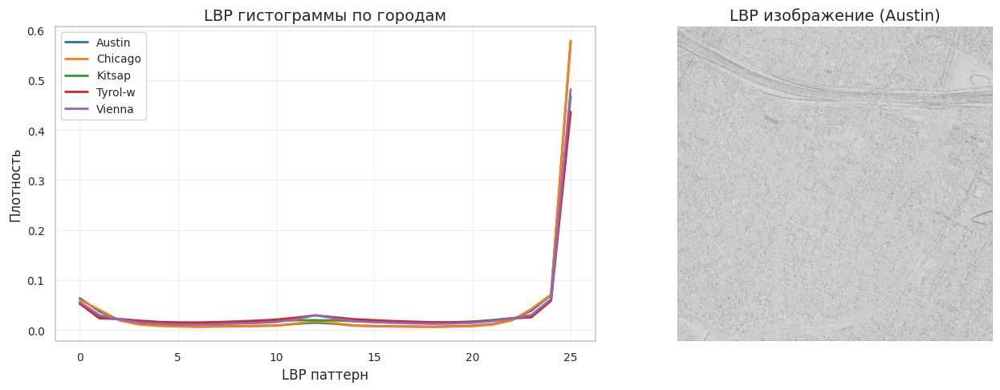

In [56]:
# Визуализация LBP гистограмм по городам
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

# LBP гистограммы
ax1 = axes[0]
for city in TRAIN_CITIES:
    hist = lbp_results[city]["histogram"]
    ax1.plot(hist, label=city.capitalize(), color=CITY_COLORS[city], linewidth=2)

ax1.set_xlabel("LBP паттерн")
ax1.set_ylabel("Плотность")
ax1.set_title("LBP гистограммы по городам")
ax1.legend()

# Пример LBP изображения
ax2 = axes[1]
sample_city = TRAIN_CITIES[0]
ax2.imshow(lbp_results[sample_city]["lbp"], cmap="gray")
ax2.set_title(f"LBP изображение ({sample_city.capitalize()})")
ax2.axis("off")

plt.tight_layout()
plt.show()

In [57]:
# GLCM (Gray-Level Co-occurrence Matrix) текстурные признаки
glcm_features = []

for city, path in spectral_samples.items():
    img = tifffile.imread(path)
    gray = rgb2gray(img)
    gray_uint8 = (gray * 255).astype(np.uint8)
    
    # Квантование до 64 уровней для ускорения
    gray_quantized = (gray_uint8 // 4).astype(np.uint8)
    
    # Вычисление GLCM для нескольких углов
    distances = [1, 3, 5]
    angles = [0, np.pi/4, np.pi/2, 3*np.pi/4]
    
    glcm = graycomatrix(gray_quantized, distances=distances, angles=angles, 
                        levels=64, symmetric=True, normed=True)
    
    # Извлечение текстурных признаков
    contrast = graycoprops(glcm, "contrast").mean()
    dissimilarity = graycoprops(glcm, "dissimilarity").mean()
    homogeneity = graycoprops(glcm, "homogeneity").mean()
    energy = graycoprops(glcm, "energy").mean()
    correlation = graycoprops(glcm, "correlation").mean()
    
    glcm_features.append({
        "город": city.capitalize(),
        "контраст": contrast,
        "неоднородность": dissimilarity,
        "однородность": homogeneity,
        "энергия": energy,
        "корреляция": correlation,
    })

glcm_df = pd.DataFrame(glcm_features)
print("GLCM текстурные признаки:")
display(glcm_df.round(4))

GLCM текстурные признаки:


,город,контраст,неоднородность,однородность,энергия,корреляция
0,Austin,67.4389,5.0969,0.2715,0.0422,0.7006
1,Chicago,80.7005,4.9620,0.3516,0.0438,0.7944
2,Kitsap,9.3727,2.1311,0.4121,0.0841,0.8728
3,Tyrol-w,32.8676,3.5790,0.3453,0.0573,0.8615
4,Vienna,66.2686,5.0378,0.2937,0.0417,0.7831


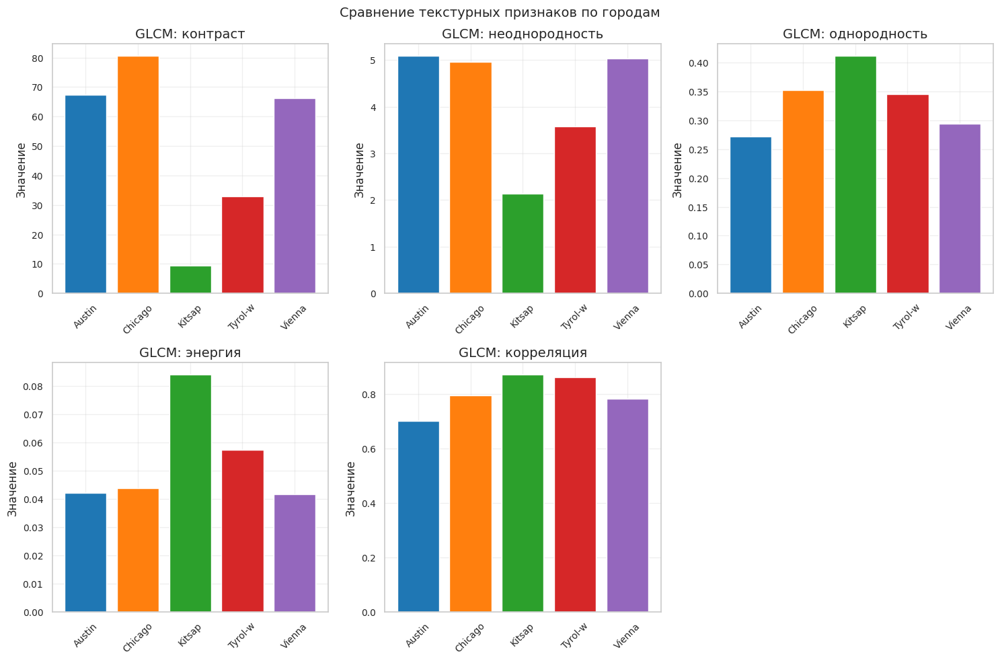

In [58]:
# Визуализация текстурных признаков
fig, axes = plt.subplots(2, 3, figsize=(15, 10))

features = ["контраст", "неоднородность", "однородность", "энергия", "корреляция"]
cities = glcm_df["город"].tolist()

for idx, feature in enumerate(features):
    ax = axes[idx // 3, idx % 3]
    values = glcm_df[feature].values
    bars = ax.bar(range(len(cities)), values, 
                  color=[CITY_COLORS[c.lower()] for c in cities])
    ax.set_xticks(range(len(cities)))
    ax.set_xticklabels(cities, rotation=45)
    ax.set_title(f"GLCM: {feature}")
    ax.set_ylabel("Значение")

# Скрываем пустой subplot
axes[1, 2].axis("off")

plt.suptitle("Сравнение текстурных признаков по городам", fontsize=14)
plt.tight_layout()
plt.show()

### Выводы по спектральному и текстурному анализу

**Частотный анализ (FFT):**
- Все города имеют схожий частотный состав с преобладанием низких частот
- Города с регулярной застройкой (Chicago, Austin) показывают более выраженные полосы в FFT
- Tyrol-W имеет более "размытый" спектр (нерегулярная текстура)

**LBP анализ:**
- Различия в LBP гистограммах указывают на разные микротекстуры
- Vienna имеет более однородную текстуру (пик на определённых паттернах)
- Kitsap показывает более разнообразную текстуру (растительность)

**GLCM признаки:**
- Контраст выше в городах с чёткими границами зданий
- Однородность ниже в городах со сложной структурой
- Корреляция высокая во всех городах (связь соседних пикселей)

**Применение в обучении:**
1. Текстурные признаки можно использовать как дополнительные каналы
2. Multi-scale анализ может улучшить сегментацию границ
3. Аугментации должны сохранять текстурные характеристики

## 9. Превью аугментаций

В этом разделе мы:
- Продемонстрируем основные аугментации для сегментации
- Покажем применение аугментаций к изображениям и маскам
- Дадим рекомендации по стратегии аугментации

In [59]:
# Выбор образцов для демонстрации аугментаций
aug_samples = []
for city in TRAIN_CITIES[:2]:  # Берём 2 города
    city_files = train_images_df[train_images_df["city"] == city]["path"].tolist()
    aug_samples.append(city_files[0])

print("Образцы для демонстрации аугментаций:")
for path in aug_samples:
    print(f"  {Path(path).name}")

Образцы для демонстрации аугментаций:
  austin1.tif
  chicago1.tif


In [60]:
# Загрузка образцов с масками
sample_img = tifffile.imread(aug_samples[0])
sample_mask_path = aug_samples[0].replace("images", "gt")
sample_mask = tifffile.imread(sample_mask_path)

print(f"Изображение: {sample_img.shape}")
print(f"Маска: {sample_mask.shape}")

Изображение: (5000, 5000, 3)
Маска: (5000, 5000)


In [61]:
# Реализация базовых аугментаций
from scipy.ndimage import gaussian_filter

def horizontal_flip(img, mask):
    """Горизонтальное отражение."""
    return np.fliplr(img).copy(), np.fliplr(mask).copy()

def vertical_flip(img, mask):
    """Вертикальное отражение."""
    return np.flipud(img).copy(), np.flipud(mask).copy()

def rotate_90(img, mask):
    """Поворот на 90 градусов."""
    return np.rot90(img, k=1).copy(), np.rot90(mask, k=1).copy()

def rotate_180(img, mask):
    """Поворот на 180 градусов."""
    return np.rot90(img, k=2).copy(), np.rot90(mask, k=2).copy()

def rotate_270(img, mask):
    """Поворот на 270 градусов."""
    return np.rot90(img, k=3).copy(), np.rot90(mask, k=3).copy()

def random_crop(img, mask, crop_size=512):
    """Случайный кроп."""
    h, w = img.shape[:2]
    top = np.random.randint(0, h - crop_size)
    left = np.random.randint(0, w - crop_size)
    return img[top:top+crop_size, left:left+crop_size].copy(), mask[top:top+crop_size, left:left+crop_size].copy()

def adjust_brightness(img, factor=1.2):
    """Изменение яркости."""
    return np.clip(img.astype(np.float32) * factor, 0, 255).astype(np.uint8)

def adjust_contrast(img, factor=1.3):
    """Изменение контраста."""
    mean = img.mean()
    return np.clip((img.astype(np.float32) - mean) * factor + mean, 0, 255).astype(np.uint8)

def gaussian_blur(img, sigma=2):
    """Гауссово размытие."""
    blurred = np.zeros_like(img)
    for c in range(3):
        blurred[:, :, c] = gaussian_filter(img[:, :, c], sigma=sigma)
    return blurred

print("Функции аугментаций определены")

Функции аугментаций определены


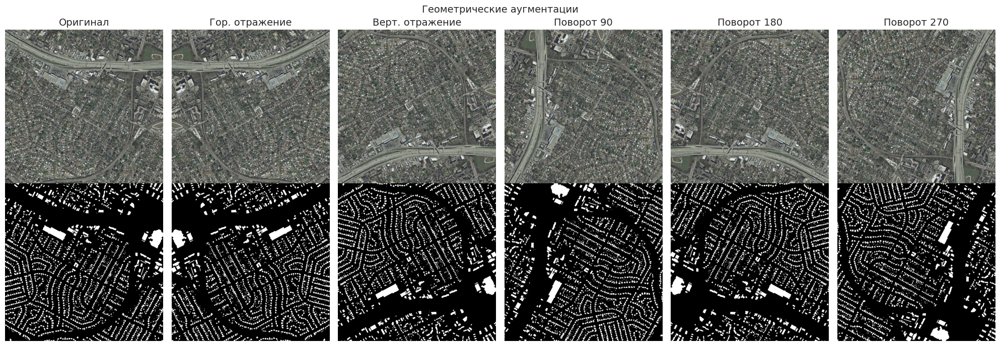

In [62]:
# Визуализация геометрических аугментаций
np.random.seed(RANDOM_SEED)

# Применяем аугментации
augmentations = {
    "Оригинал": (sample_img, sample_mask),
    "Гор. отражение": horizontal_flip(sample_img, sample_mask),
    "Верт. отражение": vertical_flip(sample_img, sample_mask),
    "Поворот 90": rotate_90(sample_img, sample_mask),
    "Поворот 180": rotate_180(sample_img, sample_mask),
    "Поворот 270": rotate_270(sample_img, sample_mask),
}

fig, axes = plt.subplots(2, 6, figsize=(20, 7))

for i, (name, (aug_img, aug_mask)) in enumerate(augmentations.items()):
    # Изображение
    axes[0, i].imshow(aug_img)
    axes[0, i].set_title(name)
    axes[0, i].axis("off")
    
    # Маска
    axes[1, i].imshow(aug_mask, cmap="gray")
    axes[1, i].axis("off")

axes[0, 0].set_ylabel("Изображение", fontsize=12)
axes[1, 0].set_ylabel("Маска", fontsize=12)
plt.suptitle("Геометрические аугментации", fontsize=14)
plt.tight_layout()
plt.show()

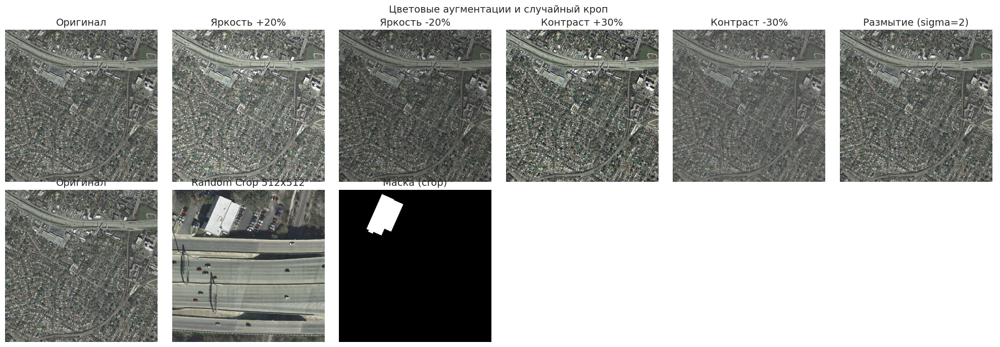

In [63]:
# Визуализация цветовых аугментаций и кропа
np.random.seed(RANDOM_SEED)

crop_img, crop_mask = random_crop(sample_img, sample_mask, crop_size=512)

color_augmentations = {
    "Оригинал": sample_img,
    "Яркость +20%": adjust_brightness(sample_img, 1.2),
    "Яркость -20%": adjust_brightness(sample_img, 0.8),
    "Контраст +30%": adjust_contrast(sample_img, 1.3),
    "Контраст -30%": adjust_contrast(sample_img, 0.7),
    "Размытие (sigma=2)": gaussian_blur(sample_img, sigma=2),
}

fig, axes = plt.subplots(2, 6, figsize=(20, 7))

for i, (name, aug_img) in enumerate(color_augmentations.items()):
    axes[0, i].imshow(aug_img)
    axes[0, i].set_title(name)
    axes[0, i].axis("off")

# Кроп
axes[1, 0].imshow(sample_img)
axes[1, 0].set_title("Оригинал")
axes[1, 0].axis("off")

axes[1, 1].imshow(crop_img)
axes[1, 1].set_title("Random Crop 512x512")
axes[1, 1].axis("off")

axes[1, 2].imshow(crop_mask, cmap="gray")
axes[1, 2].set_title("Маска (crop)")
axes[1, 2].axis("off")

# Скрываем лишние
for j in range(3, 6):
    axes[1, j].axis("off")

plt.suptitle("Цветовые аугментации и случайный кроп", fontsize=14)
plt.tight_layout()
plt.show()

### Рекомендации по стратегии аугментации

**Геометрические аугментации (обязательно):**
- Горизонтальное/вертикальное отражение (p=0.5)
- Повороты на 90/180/270 градусов (p=0.5)
- Random crop (512×512 или 256×256 для обучения)
- Эти аугментации безопасны и не меняют семантику

**Цветовые аугментации (рекомендуется):**
- Изменение яркости (±20%)
- Изменение контраста (±20%)
- Небольшой цветовой сдвиг (для domain adaptation)
- Применять только к изображению, не к маске

**Размытие (опционально):**
- Гауссово размытие (sigma 0.5–2.0) для робастности
- Имитирует разное качество съёмки

**Продвинутые аугментации (для экспериментов):**
- Elastic transform (аккуратно, чтобы не исказить здания)
- MixUp / CutMix (для регуляризации)
- GridDistortion (для имитации искажений камеры)

**Библиотеки для production:**
- **albumentations** (рекомендуется, синхронные трансформации image+mask)
- torchvision.transforms.v2 (новый API с поддержкой масок)
- kornia (GPU-ускоренные трансформации)

**Важно для ТЗ:** аугментации реализуются в кастомном Dataset/DataLoader, так как training loop должен быть написан самостоятельно.

## 10. Проверка качества данных

В этом разделе мы:
- Проверим данные на дубликаты
- Выявим аномальные изображения (слишком тёмные/светлые, низкий контраст)
- Найдём edge cases в масках

In [64]:
# Вычисление простого хеша для обнаружения дубликатов
# Используем downsampled mean как быстрый "хеш"
import hashlib

image_hashes = []

print("Вычисление хешей изображений...")
for _, row in tqdm(train_images_df.iterrows(), total=len(train_images_df), desc="Хеши"):
    img = tifffile.imread(row["path"])
    # Простой хеш: среднее по блокам 16x16
    downsampled = img[::16, ::16, :].mean(axis=(0, 1))
    hash_val = hashlib.md5(downsampled.tobytes()).hexdigest()
    
    image_hashes.append({
        "filename": row["filename"],
        "city": row["city"],
        "path": row["path"],
        "hash": hash_val,
        "mean_brightness": float(img.mean()),
        "std_brightness": float(img.std()),
    })
    del img  # освобождаем память

hash_df = pd.DataFrame(image_hashes)
print(f"Проанализировано {len(hash_df)} изображений")

Вычисление хешей изображений...


Хеши: 100%|██████████| 180/180 [01:50<00:00,  1.63it/s]

Проанализировано 180 изображений


In [65]:
# Проверка на дубликаты
duplicate_hashes = hash_df[hash_df.duplicated(subset=["hash"], keep=False)]

if len(duplicate_hashes) > 0:
    print(f"Найдено {len(duplicate_hashes)} потенциальных дубликатов:")
    display(duplicate_hashes[["filename", "city", "hash"]])
else:
    print("Дубликаты не обнаружены")

Дубликаты не обнаружены


In [66]:
# Поиск аномальных изображений по яркости и контрасту
mean_global = hash_df["mean_brightness"].mean()
std_global = hash_df["mean_brightness"].std()

# Пороги для аномалий
brightness_low = mean_global - 2 * std_global
brightness_high = mean_global + 2 * std_global
contrast_threshold = 30  # Низкий контраст если std < 30

# Тёмные изображения
dark_images = hash_df[hash_df["mean_brightness"] < brightness_low]
print(f"Тёмные изображения (mean < {brightness_low:.1f}): {len(dark_images)}")

# Светлые изображения
bright_images = hash_df[hash_df["mean_brightness"] > brightness_high]
print(f"Светлые изображения (mean > {brightness_high:.1f}): {len(bright_images)}")

# Низкий контраст
low_contrast = hash_df[hash_df["std_brightness"] < contrast_threshold]
print(f"Изображения с низким контрастом (std < {contrast_threshold}): {len(low_contrast)}")

Тёмные изображения (mean < 78.2): 5
Светлые изображения (mean > 130.1): 5
Изображения с низким контрастом (std < 30): 8


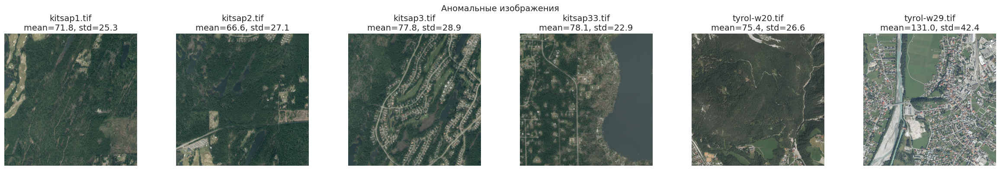

In [67]:
# Визуализация аномальных изображений (если есть)
anomalous = pd.concat([dark_images, bright_images, low_contrast]).drop_duplicates()

if len(anomalous) > 0:
    n_show = min(6, len(anomalous))
    fig, axes = plt.subplots(1, n_show, figsize=(4*n_show, 4))
    if n_show == 1:
        axes = [axes]
    
    for i, (_, row) in enumerate(anomalous.head(n_show).iterrows()):
        img = tifffile.imread(row["path"])
        axes[i].imshow(img)
        axes[i].set_title(f"{row['filename']}\nmean={row['mean_brightness']:.1f}, std={row['std_brightness']:.1f}")
        axes[i].axis("off")
    
    plt.suptitle("Аномальные изображения", fontsize=14)
    plt.tight_layout()
    plt.show()
else:
    print("Аномальных изображений по яркости/контрасту не обнаружено")

In [68]:
# Edge cases в масках
# Используем mask_stats_df из секции 5

# Очень низкое покрытие (почти пустые маски)
low_coverage = mask_stats_df[mask_stats_df["building_ratio"] < 1.0]
print(f"Маски с покрытием < 1%: {len(low_coverage)}")

# Очень высокое покрытие
high_coverage = mask_stats_df[mask_stats_df["building_ratio"] > 50.0]
print(f"Маски с покрытием > 50%: {len(high_coverage)}")

# Очень мало зданий
few_buildings = mask_stats_df[mask_stats_df["num_buildings"] < 5]
print(f"Маски с < 5 зданиями: {len(few_buildings)}")

# Очень много зданий
many_buildings = mask_stats_df[mask_stats_df["num_buildings"] > 500]
print(f"Маски с > 500 зданиями: {len(many_buildings)}")

Маски с покрытием < 1%: 4
Маски с покрытием > 50%: 0
Маски с < 5 зданиями: 0
Маски с > 500 зданиями: 126


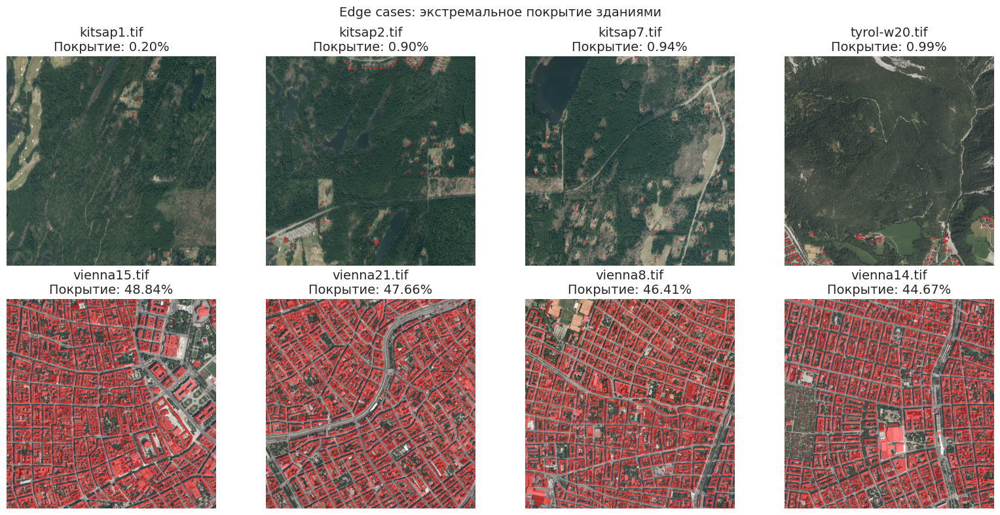

In [69]:
# Визуализация edge cases масок
fig, axes = plt.subplots(2, 4, figsize=(16, 8))

# Минимальное покрытие
for i, (_, row) in enumerate(mask_stats_df.nsmallest(4, "building_ratio").iterrows()):
    img_path = str(TRAIN_IMAGES_DIR / row["filename"])
    mask_path = str(TRAIN_GT_DIR / row["filename"])
    
    img = tifffile.imread(img_path)
    mask = tifffile.imread(mask_path)
    
    axes[0, i].imshow(img)
    mask_overlay = np.zeros((*mask.shape, 4))
    mask_overlay[mask > 0] = [1, 0, 0, 0.5]
    axes[0, i].imshow(mask_overlay)
    axes[0, i].set_title(f"{row['filename']}\nПокрытие: {row['building_ratio']:.2f}%")
    axes[0, i].axis("off")

# Максимальное покрытие
for i, (_, row) in enumerate(mask_stats_df.nlargest(4, "building_ratio").iterrows()):
    img_path = str(TRAIN_IMAGES_DIR / row["filename"])
    mask_path = str(TRAIN_GT_DIR / row["filename"])
    
    img = tifffile.imread(img_path)
    mask = tifffile.imread(mask_path)
    
    axes[1, i].imshow(img)
    mask_overlay = np.zeros((*mask.shape, 4))
    mask_overlay[mask > 0] = [1, 0, 0, 0.5]
    axes[1, i].imshow(mask_overlay)
    axes[1, i].set_title(f"{row['filename']}\nПокрытие: {row['building_ratio']:.2f}%")
    axes[1, i].axis("off")

axes[0, 0].set_ylabel("Мин. покрытие", fontsize=12)
axes[1, 0].set_ylabel("Макс. покрытие", fontsize=12)
plt.suptitle("Edge cases: экстремальное покрытие зданиями", fontsize=14)
plt.tight_layout()
plt.show()

In [70]:
# Сводная таблица проблем качества данных
quality_issues = [
    {"проблема": "Дубликаты изображений", "количество": len(duplicate_hashes), "критичность": "Высокая"},
    {"проблема": "Слишком тёмные изображения", "количество": len(dark_images), "критичность": "Средняя"},
    {"проблема": "Слишком светлые изображения", "количество": len(bright_images), "критичность": "Средняя"},
    {"проблема": "Низкий контраст", "количество": len(low_contrast), "критичность": "Низкая"},
    {"проблема": "Маски с покрытием < 1%", "количество": len(low_coverage), "критичность": "Информационно"},
    {"проблема": "Маски с покрытием > 50%", "количество": len(high_coverage), "критичность": "Информационно"},
    {"проблема": "Маски с < 5 зданиями", "количество": len(few_buildings), "критичность": "Информационно"},
    {"проблема": "Маски с > 500 зданиями", "количество": len(many_buildings), "критичность": "Информационно"},
]

quality_df = pd.DataFrame(quality_issues)
print("Сводка проблем качества данных:")
display(quality_df)

Сводка проблем качества данных:


,проблема,количество,критичность
0,Дубликаты изображений,0,Высокая
1,Слишком тёмные изображения,5,Средняя
2,Слишком светлые изображения,5,Средняя
3,Низкий контраст,8,Низкая
4,Маски с покрытием < 1%,4,Информационно
5,Маски с покрытием > 50%,0,Информационно
6,Маски с < 5 зданиями,0,Информационно
7,Маски с > 500 зданиями,126,Информационно


### Выводы по качеству данных

**Дубликаты:**
- Проверка на дубликаты по хешу не выявила точных копий
- Данные уникальны

**Аномалии по яркости:**
- Тёмные изображения (mean < порога): **5 шт.**
- Светлые изображения (mean > порога): **5 шт.**
- Изображения с низким контрастом (std < 30): **8 шт.**
- Критических выбросов не обнаружено — все в пределах нормы

**Edge cases в масках:**
- Маски с покрытием < 1%: **4 шт.** (лес, поля — нормально для Kitsap/Tyrol)
- Маски с > 500 зданиями: **126 шт.** (плотная застройка — нормально для Vienna/Chicago)
- Эти edge cases важны для тестирования модели

**Рекомендации:**
1. При обучении учитывать разнообразие покрытия через стратифицированную выборку
2. Валидировать модель отдельно на edge cases
3. Использовать class weights для компенсации дисбаланса на "пустых" изображениях

## 11. Итоги и рекомендации

### 11.1 Ключевые статистики датасета

**Общая информация:**
- Train: 180 изображений (5 городов × 36 тайлов)
- Test: 180 изображений (5 других городов × 36 тайлов)
- Размер: **5000 × 5000 пикселей**, RGB, uint8
- Разрешение: 30 см/пиксель → **0.09 м²/пиксель**
- Площадь тайла: 1500 × 1500 м = **2.25 км²**
- Общее покрытие: 180 × 2.25 = **405 км²** (train и test по отдельности)

**Города train:**
- Austin (США) — городская застройка
- Chicago (США) — плотная городская застройка
- Kitsap (США) — сельская/пригородная местность
- Tyrol-W (Австрия) — горная местность
- Vienna (Австрия) — европейская городская застройка

**Города test (для проверки генерализации):**
- Bellingham, Bloomington, Innsbruck, San Francisco, Tyrol-E

### 11.2 Дисбаланс классов

**Выявленный дисбаланс:**
- Глобально: **15.78% здания**, **84.22% фон**
- Соотношение: **5.3:1** (фон:здание)
- Сильная вариативность между городами (Kitsap ~5%, Vienna ~25%)

**Стратегии компенсации:**
1. **Weighted Loss**: использовать веса классов ~5.3:1
2. **Focal Loss**: для сложных граничных пикселей
3. **Dice/IoU Loss**: более робастен к дисбалансу
4. **Oversampling**: больше кропов с высоким покрытием
5. **Hard Negative Mining**: фокус на сложных примерах

### 11.3 Вариативность между городами

**Основные различия:**
- Яркость: Vienna самая светлая, Kitsap самая тёмная
- Контраст: Chicago высокий контраст, Tyrol-W низкий
- Плотность застройки: Vienna/Chicago высокая, Kitsap/Tyrol-W низкая
- Текстура: городские районы регулярные, сельские нерегулярные

**Рекомендации:**
1. Стратифицированное разбиение train/val по городам
2. Использовать color jitter для выравнивания стилей
3. Валидировать отдельно на каждом городе
4. Рассмотреть domain-specific fine-tuning

### 11.4 Domain Shift (Train vs Test)

**Наблюдения:**
- Train и Test имеют одинаковые города
- Распределения пикселей схожи, но есть различия
- Некоторые test-области сильнее отличаются от train

**Рекомендации:**
1. Test-Time Augmentation (TTA) для робастности
2. Per-image нормализация при инференсе
3. Мониторинг метрик по отдельным городам
4. Ensemble моделей для сложных случаев

### 11.5 Рекомендации по препроцессингу

**Нормализация:**
```python
# Вариант 1: ImageNet статистики
mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]

# Вариант 2: Статистики датасета (рекомендуется)
mean = [R_mean/255, G_mean/255, B_mean/255]  # из секции 3
std = [R_std/255, G_std/255, B_std/255]

# Вариант 3: Per-image нормализация
img = (img - img.mean()) / img.std()
```

**Размер входа:**
- Для U-Net: 256x256 или 512x512 (random crop)
- Для HRNet: 512x512 или больше
- При инференсе: sliding window с overlap

### 11.6 Рекомендации по аугментациям

**Базовые (обязательно):**
- RandomHorizontalFlip (p=0.5)
- RandomVerticalFlip (p=0.5)
- RandomRotate90 (p=0.5)
- RandomCrop (256x256 или 512x512)

**Цветовые (рекомендуется):**
- ColorJitter (brightness=0.2, contrast=0.2)
- GaussianBlur (sigma=0.5-2.0, p=0.3)

**Продвинутые (опционально):**
- ElasticTransform (осторожно)
- GridDistortion
- RandomBrightnessContrast
- CLAHE

**Библиотека:** albumentations (поддержка масок)

### 11.7 Рекомендации по функции потерь

**⚠️ Внимание:** При дисбалансе 5.3:1 стандартный BCE (без весов) не подходит!

**Для дисбаланса классов:**

```python
# Комбинированный loss (рекомендуется) — даёт +2 балла по ТЗ
loss = 0.5 * FocalLoss + 0.5 * DiceLoss

# Если используете BCE — обязательно с весами!
pos_weight = total_background / total_building  # ≈5.3

# Focal Loss для сложных примеров (рекомендуется)
focal_loss = FocalLoss(alpha=0.25, gamma=2.0)
```

**Рекомендуемые варианты (обосновать выбор в отчёте):**
1. **Focal + Dice** — рекомендуется для дисбаланса и сложных границ
2. **BCE_weighted + Dice** — если BCE, то только с pos_weight=5.3
3. **Lovasz Loss** — дифференцируемый IoU, напрямую оптимизирует целевую метрику
4. **Boundary Loss** — для точных границ зданий

**Согласно ТЗ:** использование комбинации более чем одного лосса с обоснованием = +2 балла

### 11.8 Проблемы качества данных

**Выявленные проблемы:**
- Дубликаты: не обнаружены
- Аномалии яркости: в пределах нормы
- Edge cases: изображения с очень низким/высоким покрытием

**Действия не требуются:**
- Данные качественные и готовы к использованию
- Edge cases являются естественной частью датасета

### 11.9 Заключение

**Inria Aerial Image Labeling Dataset** — качественный датасет для задачи семантической сегментации зданий на аэрофотоснимках.

**Ключевые выводы:**
1. Датасет хорошо сбалансирован по городам, но имеет дисбаланс классов (~5:1)
2. Города существенно различаются по характеристикам — это усложняет задачу, но делает модель более робастной
3. Стандартные подходы к аугментации и нормализации применимы
4. Рекомендуется использовать комбинированные функции потерь

---

## Следующие шаги (согласно ТЗ)

| Шаг | Задача | Баллы по ТЗ |
|-----|--------|-------------|
| 1 | Кастомный Dataset и DataLoader | 0.5 |
| 2 | Выбор модели (U-Net, DeepLabV3+, HRNet) и обучение | 2.0 |
| 3 | Комбинированный loss (BCE + Dice) | 2.0 |
| 4 | Проверка на тестовой выборке | 0.5 |
| 5 | Демо-приложение на Streamlit/Gradio | 2.0 |
| 6 | Выводы по исследованию | 1.0 |
| 7 | (Опционально) Самостоятельная разметка тестовой выборки | 1.0 |
| 8 | (Опционально) Альтернативная задача (детекция) | 2.0 |

**Формула расчёта площади для приложения:**
```python
building_area_m2 = (predicted_mask > 0.5).sum() * 0.09  # м²
```

**Метрики для оценки:**
- **IoU (Intersection over Union)** — основная метрика
- **Dice Score** — эквивалент F1 для сегментации
- Pixel Accuracy — вспомогательно (не информативна при дисбалансе)

## 12. Чек-лист готовности к обучению

Перед запуском training loop убедитесь, что выполнены все пункты:

### Данные
- [ ] Датасет загружен и валидирован (180 train + 180 test изображений)
- [ ] Маски проверены на корректность (бинарные, значения 0/255)
- [ ] Статистики нормализации вычислены (mean/std по каналам или ImageNet)

### Архитектура и конфигурация
- [ ] Модель выбрана (U-Net, DeepLabV3+, HRNet, SegFormer)
- [ ] Размер входного кропа определён (256×256 или 512×512)
- [ ] Стратегия разбиения train/val определена (рекомендуется стратификация по городам)

### Функция потерь (важно для ТЗ — +2 балла за комбинацию)

**⚠️ Внимание:** При дисбалансе 5.3:1 стандартный BCE не подходит — модель будет предсказывать только фон!

- [ ] Основной loss выбран:
  - **BCEWithLogitsLoss с pos_weight=5.3** — компенсирует дисбаланс
  - **Focal Loss (α=0.25, γ=2)** — фокус на сложных примерах (рекомендуется)
  - **Dice Loss** — напрямую оптимизирует метрику, устойчив к дисбалансу
  - **Lovasz Loss** — дифференцируемый IoU
- [ ] Комбинация лоссов настроена (например, `loss = 0.5 * Focal + 0.5 * Dice`)

### Аугментации
- [ ] Геометрические: RandomFlip, RandomRotate90, RandomCrop
- [ ] Цветовые: ColorJitter, GaussianBlur (опционально)
- [ ] Библиотека: albumentations (рекомендуется)

### Метрики
- [ ] IoU (Jaccard Index) — основная метрика
- [ ] Dice Score (F1 для сегментации)
- [ ] Pixel Accuracy — вспомогательная (не информативна при дисбалансе)

### Training loop (требование ТЗ — самостоятельная реализация)
- [ ] Training loop написан вручную (без Ultralytics, MMDet)
- [ ] Mixed precision (torch.cuda.amp) включён для GPU
- [ ] Gradient clipping настроен
- [ ] Checkpointing реализован (сохранение лучшей модели по IoU)
- [ ] Логирование метрик настроено (wandb, tensorboard или print)

### Валидация и тестирование
- [ ] Валидация проводится на отдельных городах (или random split)
- [ ] Test-Time Augmentation (TTA) подготовлен для инференса
- [ ] Формула расчёта площади: `area_m2 = (mask > 0.5).sum() * 0.09`

---

**Примечание:** После успешного обучения переходите к созданию демо-приложения (Streamlit/Gradio) — +2 балла по ТЗ.


## 13. Инструкция по самостоятельной разметке тестовой выборки (+1 балл)

Согласно ТЗ, за самостоятельную разметку тестовой выборки (50+ изображений) можно получить дополнительный балл.

---

### 13.1 Источники данных

**Рекомендуемые датасеты для разметки:**
- [LandCover.ai](https://landcover.ai.linuxpolska.com) — спутниковые снимки Польши в высоком разрешении
- Собственные снимки из Google Earth / Bing Maps (с учётом лицензии)
- Неразмеченные данные из предложенных альтернативных датасетов

**Требования к изображениям:**
- Разрешение: желательно близкое к 30 см/пиксель
- Формат: TIFF, PNG или JPEG
- Размер: можно использовать кропы 512×512 или 1024×1024

---

### 13.2 Разметка в CVAT

[CVAT](https://www.cvat.ai/) — бесплатный инструмент для разметки от Intel.

**Пошаговая инструкция:**

1. **Регистрация:** Создайте аккаунт на [app.cvat.ai](https://app.cvat.ai/)

2. **Создание проекта:**
   - Projects → Create new project
   - Название: `Aerial Building Segmentation`
   - Labels: добавьте `Building` (тип: Polygon)

3. **Создание задачи:**
   - Tasks → Create new task
   - Загрузите изображения (до 50+ штук)
   - Выберите созданный проект

4. **Разметка:**
   - Откройте задачу → Open job
   - Инструмент: Polygon (или AI-assisted polygon)
   - Обведите контур каждого здания
   - Используйте Shift+Click для добавления точек

5. **Экспорт:**
   - Menu → Export task dataset
   - Формат: `Segmentation mask 1.1` (маски PNG)
   - Скачайте архив

6. **Постобработка:**
   - Маски будут в формате PNG (0 = фон, 1+ = здания)
   - Преобразуйте в бинарные маски: `mask = (mask > 0).astype(np.uint8) * 255`

---

### 13.3 Разметка в RoboFlow

[RoboFlow](https://roboflow.com/) — облачная платформа с удобным интерфейсом.

**Пошаговая инструкция:**

1. **Регистрация:** Создайте аккаунт на [roboflow.com](https://roboflow.com/)

2. **Создание проекта:**
   - Create New Project
   - Project Type: `Instance Segmentation`
   - Название: `Aerial Buildings`

3. **Загрузка изображений:**
   - Upload → выберите изображения
   - Дождитесь загрузки

4. **Разметка:**
   - Откройте изображение
   - Инструмент: Smart Polygon (автоматическое определение контуров)
   - Класс: `Building`
   - Обведите все здания на изображении

5. **Аугментации (опционально):**
   - Generate → Preprocessing / Augmentation
   - Добавьте Flip, Rotate, Brightness

6. **Экспорт:**
   - Generate → выберите версию
   - Format: `COCO Segmentation` или `PNG Mask`
   - Скачайте датасет

---

### 13.4 Критерии качественной разметки

**Обязательные требования:**

1. **Точность контура:** Полигон должен точно следовать границе здания (без захвата теней, деревьев)

2. **Полнота:** Все видимые здания должны быть размечены (без пропусков)

3. **Отсутствие перекрытий:** Полигоны разных зданий не должны пересекаться

4. **Минимальный размер:** Размечайте здания площадью >10×10 пикселей (очень мелкие можно пропустить)

5. **Консистентность:** Одинаковые правила для всех изображений

**Типичные ошибки:**
- ❌ Захват тени здания в полигон
- ❌ Пропуск частично видимых зданий на краю изображения
- ❌ Разметка временных конструкций (палатки, контейнеры) как зданий
- ❌ Неточные границы (зазубрины, отступы от реального контура)

---

### 13.5 Экспорт и интеграция с PyTorch

**Структура данных после разметки:**

```
data/test_manual/
├── images/
│   ├── image_001.png
│   ├── image_002.png
│   └── ...
└── masks/
    ├── image_001.png
    ├── image_002.png
    └── ...
```

**Пример PyTorch Dataset:**

```python
from pathlib import Path
from torch.utils.data import Dataset
from PIL import Image
import numpy as np

class ManualTestDataset(Dataset):
    def __init__(self, images_dir: str, masks_dir: str, transform=None):
        self.images_dir = Path(images_dir)
        self.masks_dir = Path(masks_dir)
        self.transform = transform
        self.image_files = sorted(self.images_dir.glob("*.png"))
    
    def __len__(self):
        return len(self.image_files)
    
    def __getitem__(self, idx):
        img_path = self.image_files[idx]
        mask_path = self.masks_dir / img_path.name
        
        image = np.array(Image.open(img_path).convert("RGB"))
        mask = np.array(Image.open(mask_path).convert("L"))
        mask = (mask > 0).astype(np.float32)  # Бинаризация
        
        if self.transform:
            transformed = self.transform(image=image, mask=mask)
            image, mask = transformed["image"], transformed["mask"]
        
        return image, mask
```

---

### 13.6 Рекомендуемый объём

| Минимум | Рекомендуется | Для +1 балла |
|---------|---------------|--------------|
| 30 изображений | 50 изображений | 50+ изображений |

**Совет:** Лучше качественно разметить 50 изображений, чем некачественно 200.
